In [1]:
import numpy as np
import matplotlib.pyplot as plt
import _pickle as pkl
import pandas as pd
import os,io,sys,glob, h5py, csv, time
import matplotlib.pyplot as plt
import json

from dlab import generalephys as ephys
from dlab import generalephys_mua as ephys_mua
from dlab import cell_pairs as pairs

from dlab import utils_pipeline as utils
#from dlab import utils_mua
from dlab import analysis_pipeline as analysis

from dlab.continuous_traces import gaussian_filter1d
from scipy.signal import find_peaks
from scipy.stats import pearsonr, spearmanr, zscore
from itertools import combinations 
from dlab import sorting_quality_editing as sq
from sklearn.manifold import TSNE
from scipy.cluster.vq import kmeans2
#from dlab import depth_estimation as depth
#from dlab import PCA as pca


import seaborn as sns
sns.set_style('white')
%matplotlib inline
%load_ext autoreload
%autoreload 2
sns.set_style("white")
import warnings
warnings.filterwarnings('ignore')

# load files created from pre-processing pipeline

In [2]:
startimes_path = r'C:\Users\16623\Desktop\kim_analysis'
path = r'C:\Users\16623\Desktop\kim_analysis\kimcode_02.2020\PIPELINE'

df = pd.read_json(os.path.join(path,'df_all_mice_09_22_21.json'))
df_reaches = pd.read_json(os.path.join(path,'df_reaches_all_mice.json'))
df_reaches =  pd.read_json(r'C:\Users\16623\Desktop\kim_analysis\kimcode_02.2020\PIPELINE\df_reaches_aligned_092121.json')
df_start = pd.read_csv(os.path.join(startimes_path,'Neuropixels_ProcessorStartTimes.csv'))
df_timestamps = pd.read_json(os.path.join(path,'df_timestamps.json'))
df_sq = pd.read_json(os.path.join(path,'df_sq_all_mice_09_02_21.json'))

# synchronize behavior & ephys data

Converts reachmax frames to time in seconds based on software start time

mouse: 11
number of timestamps: (1083326,)
remove odd indices? (yes or no) yes
removed odd indices
aligned
plotting heatmap to confirm
creating heatmap for 11.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


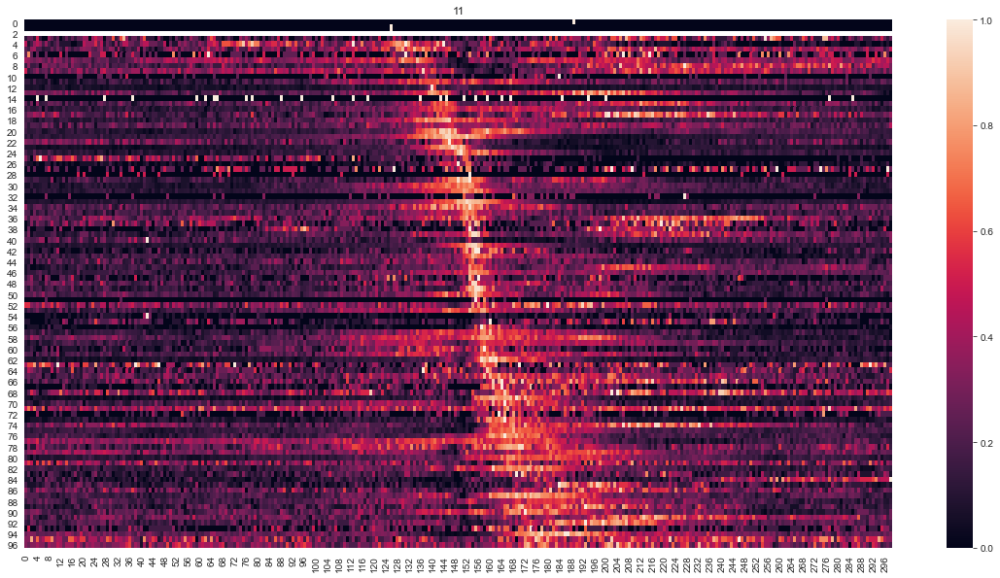

heatmap complete
is this correct? (yes or no) yes
mouse: 12
number of timestamps: (1083334,)
remove odd indices? (yes or no) yes
removed odd indices
aligned
plotting heatmap to confirm
creating heatmap for 12.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


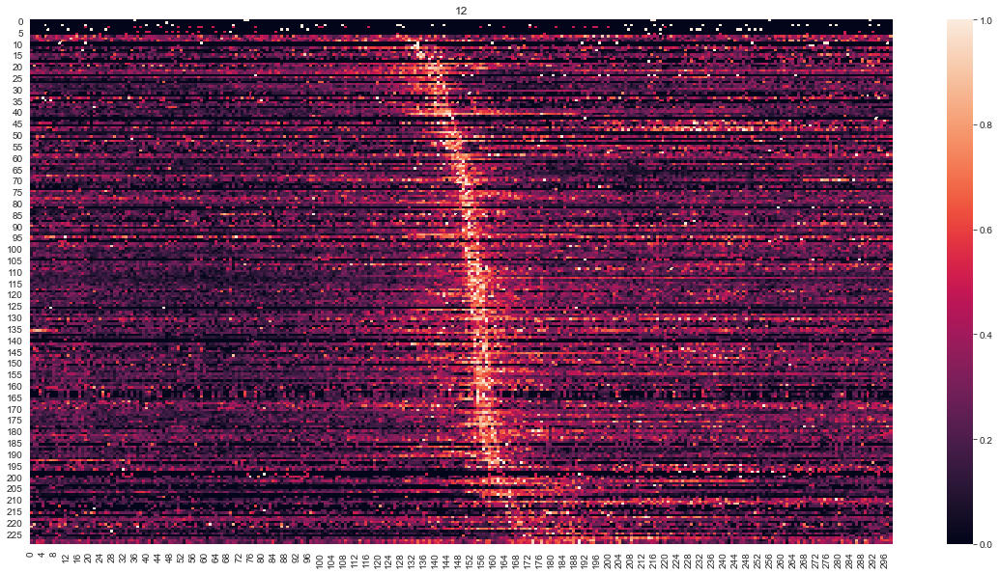

heatmap complete
is this correct? (yes or no) yes
mouse: 22
number of timestamps: (180634,)
remove odd indices? (yes or no) yes
removed odd indices
aligned
plotting heatmap to confirm
creating heatmap for 22.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


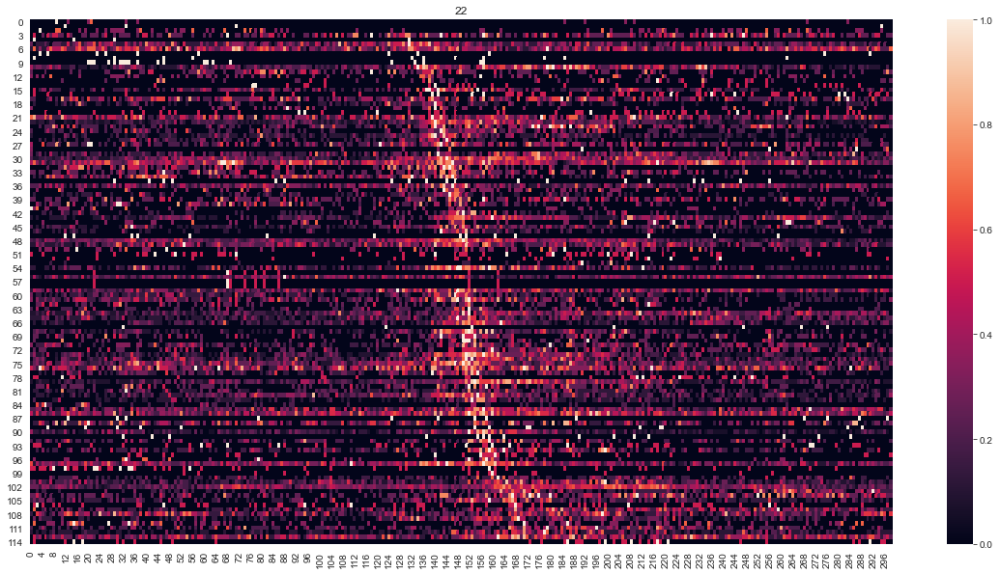

heatmap complete
is this correct? (yes or no) yes
mouse: 24
number of timestamps: (1083374,)
remove odd indices? (yes or no) yes
removed odd indices
aligned
plotting heatmap to confirm
creating heatmap for 24.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


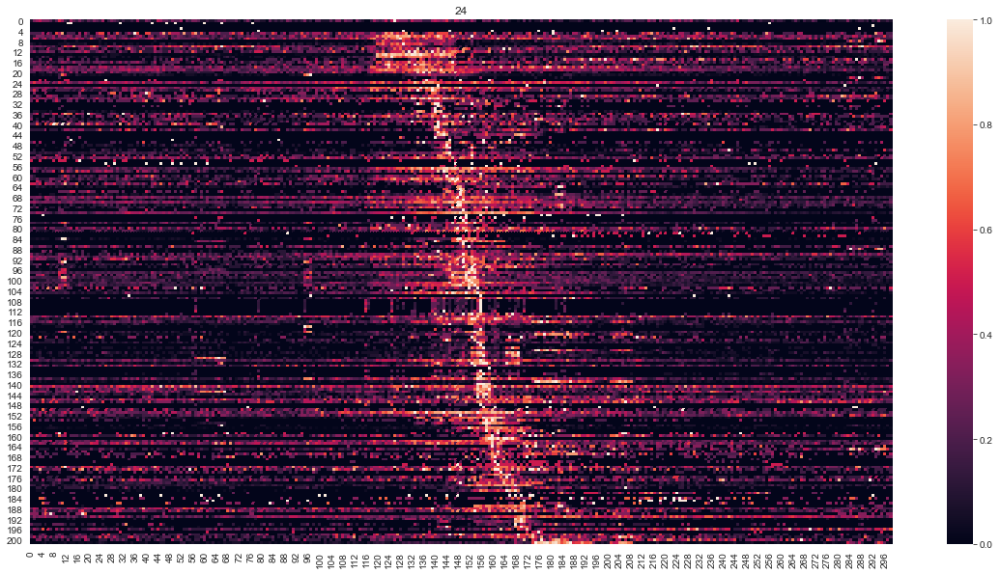

heatmap complete
is this correct? (yes or no) yes
mouse: 19
number of timestamps: (1083330,)
remove odd indices? (yes or no) yes
removed odd indices
aligned
plotting heatmap to confirm
creating heatmap for 19.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


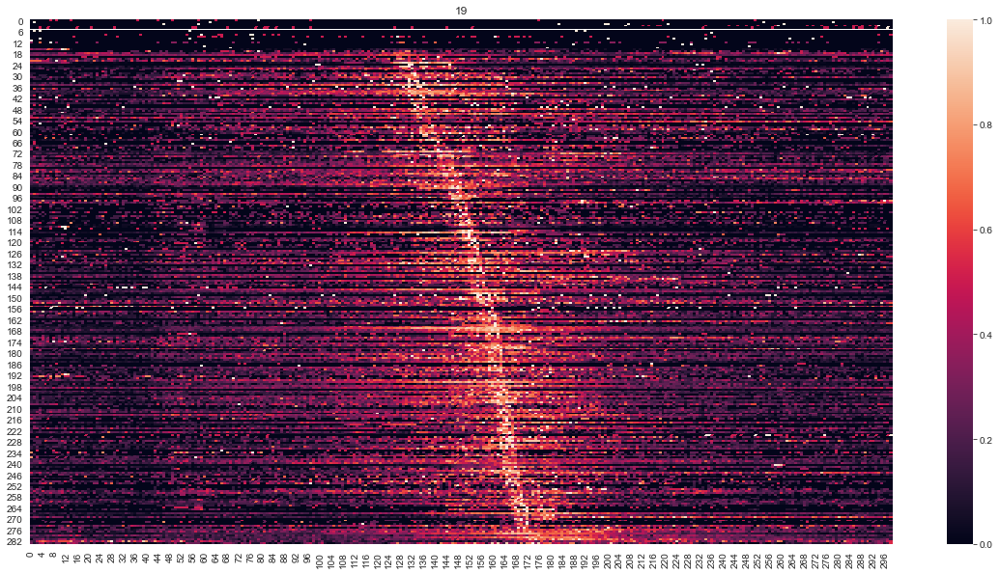

heatmap complete
is this correct? (yes or no) yes
mouse: 20
number of timestamps: (1059120,)
remove odd indices? (yes or no) yes
removed odd indices
aligned
plotting heatmap to confirm
creating heatmap for 20.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


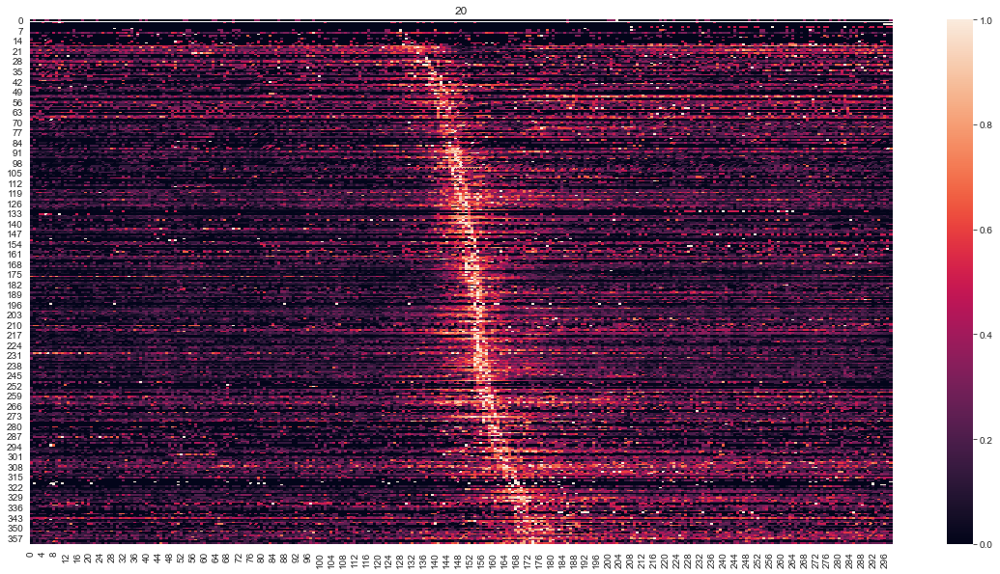

heatmap complete
is this correct? (yes or no) yes
mouse: 26
number of timestamps: (541644,)
remove odd indices? (yes or no) no
aligned
plotting heatmap to confirm
creating heatmap for 26.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


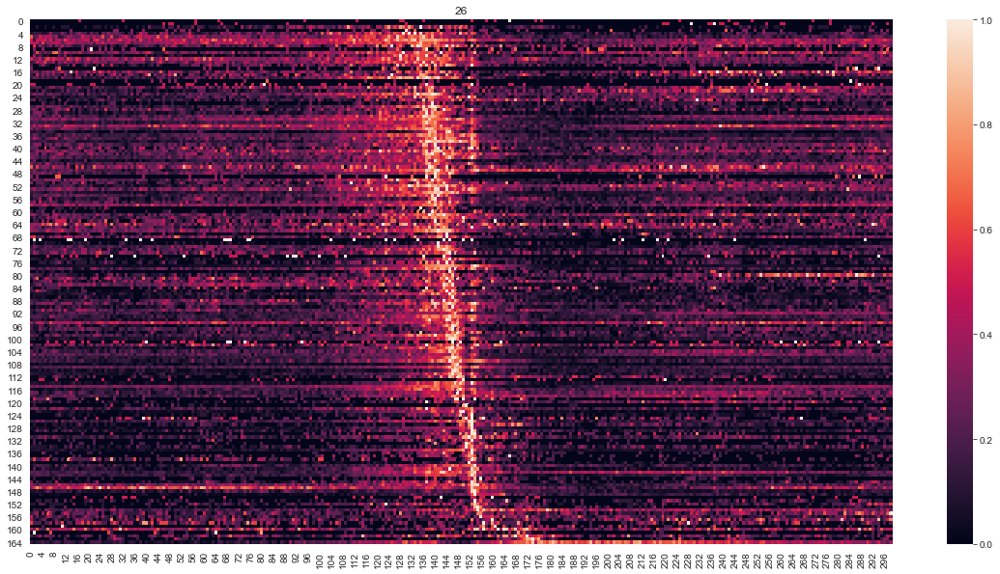

heatmap complete
is this correct? (yes or no) yes
mouse: 28
number of timestamps: (315846,)
remove odd indices? (yes or no) no
aligned
plotting heatmap to confirm
creating heatmap for 28.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


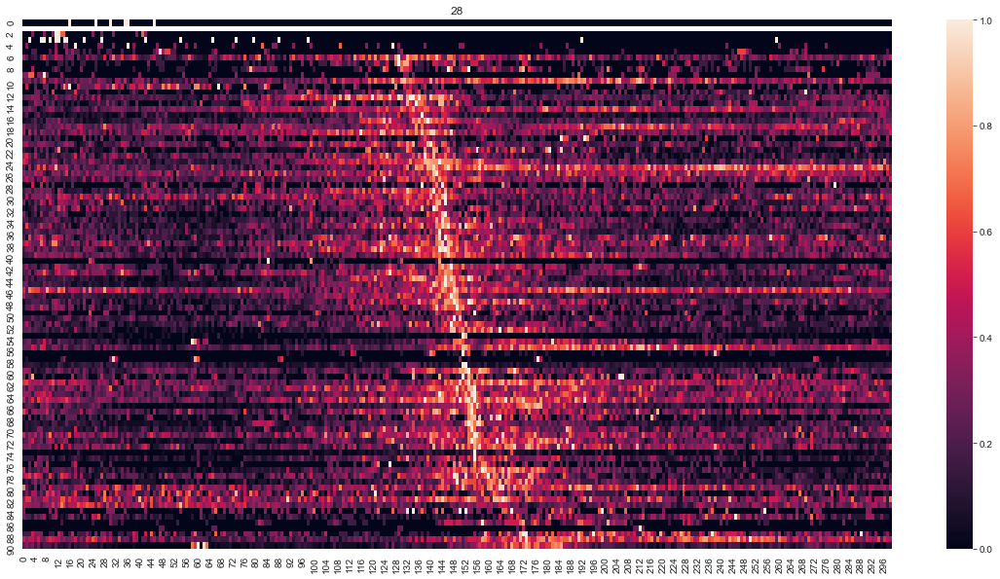

heatmap complete
is this correct? (yes or no) yes
mouse: 42
number of timestamps: (265138,)
remove odd indices? (yes or no) no
aligned
plotting heatmap to confirm
creating heatmap for 42.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


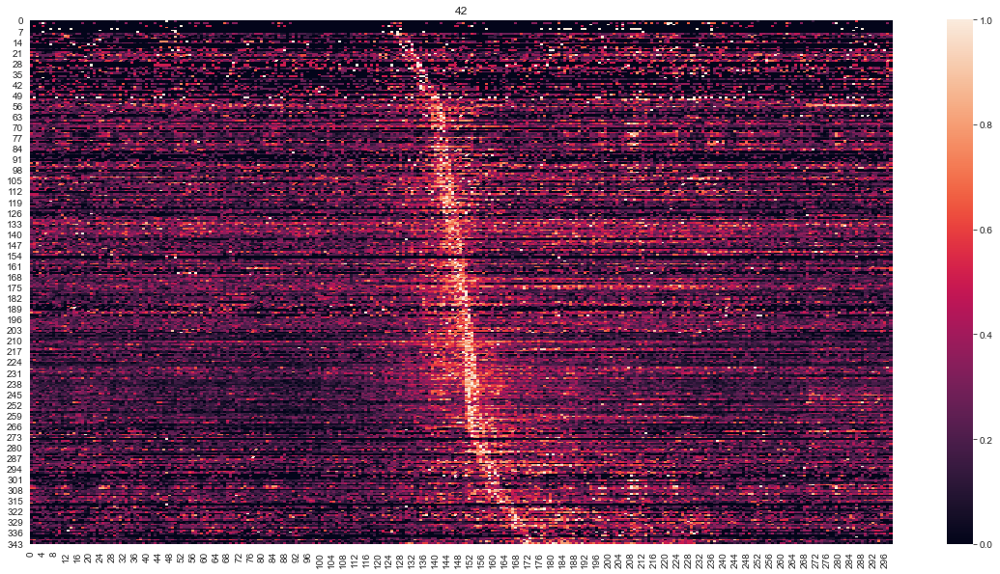

heatmap complete
is this correct? (yes or no) yes
mouse: 43
number of timestamps: (289572,)
remove odd indices? (yes or no) no
aligned
plotting heatmap to confirm
creating heatmap for 43.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


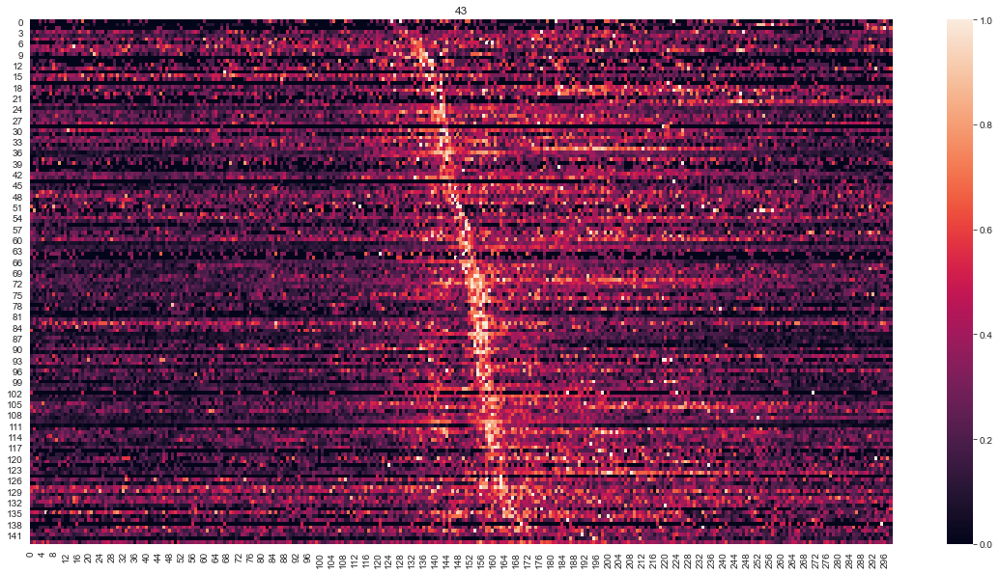

heatmap complete
is this correct? (yes or no) yes
mouse: 50
number of timestamps: (1083308,)
remove odd indices? (yes or no) yes
removed odd indices
aligned
plotting heatmap to confirm
creating heatmap for 50.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


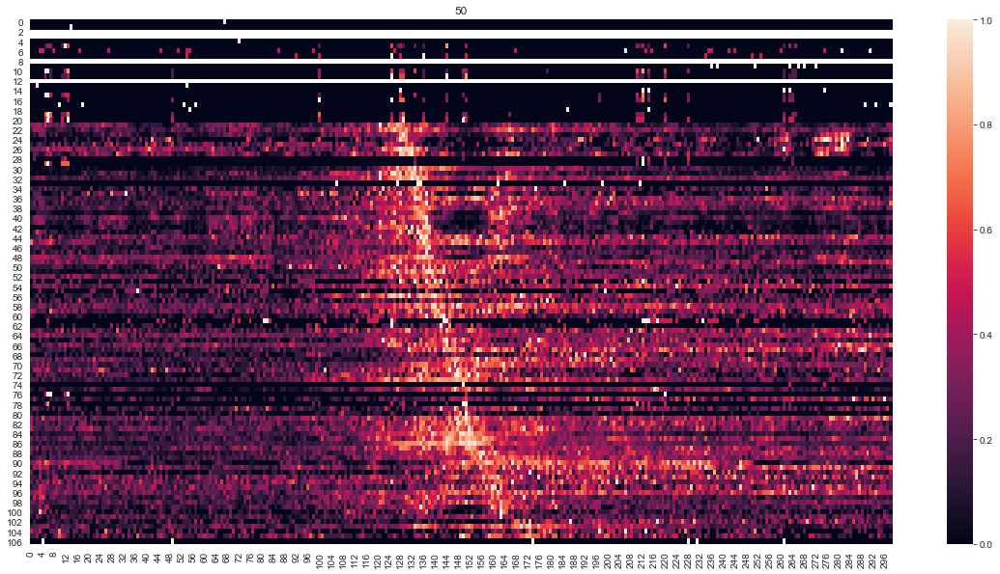

heatmap complete
is this correct? (yes or no) yes
mouse: 51
number of timestamps: (1083280,)
remove odd indices? (yes or no) yes
removed odd indices
aligned
plotting heatmap to confirm
creating heatmap for 51.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


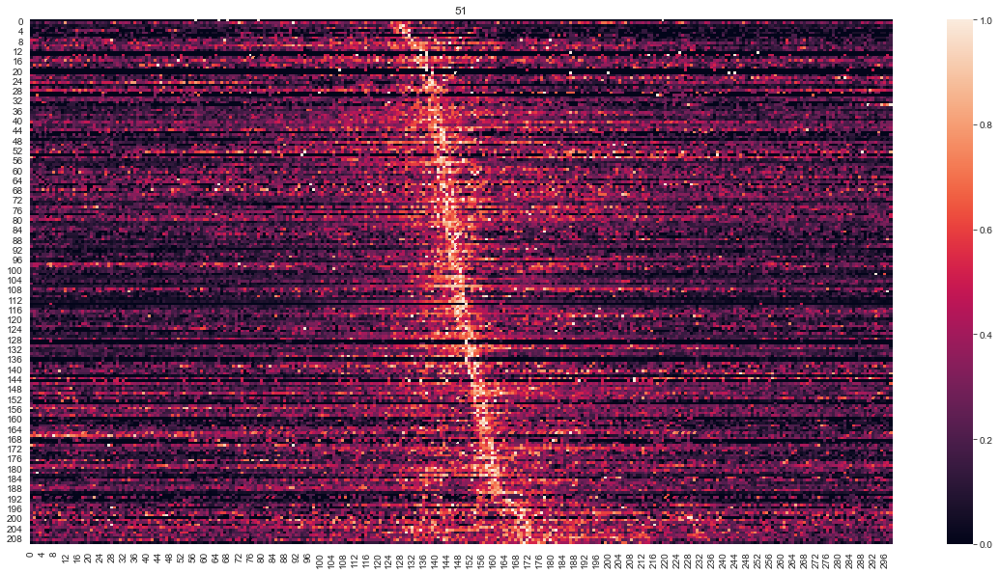

heatmap complete
is this correct? (yes or no) yes
mouse: 47
number of timestamps: (1083264,)
remove odd indices? (yes or no) yes
removed odd indices
aligned
plotting heatmap to confirm
creating heatmap for 47.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


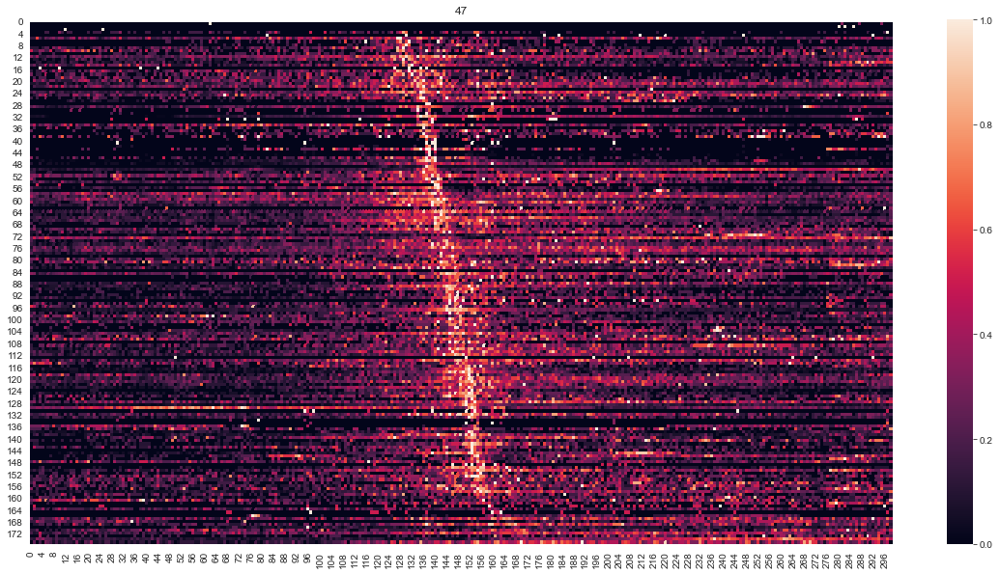

heatmap complete
is this correct? (yes or no) yes
mouse: 59
number of timestamps: (1032101,)
remove odd indices? (yes or no) no
aligned
plotting heatmap to confirm
creating heatmap for 59.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


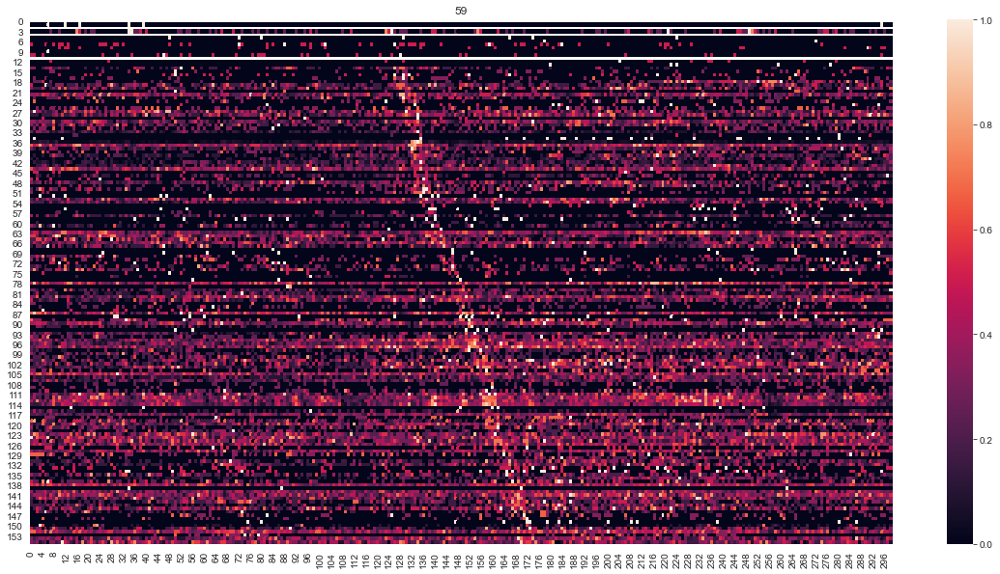

heatmap complete
is this correct? (yes or no) yes
mouse: 58
number of timestamps: (1083300,)
remove odd indices? (yes or no) yes
removed odd indices
aligned
plotting heatmap to confirm
creating heatmap for 58.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


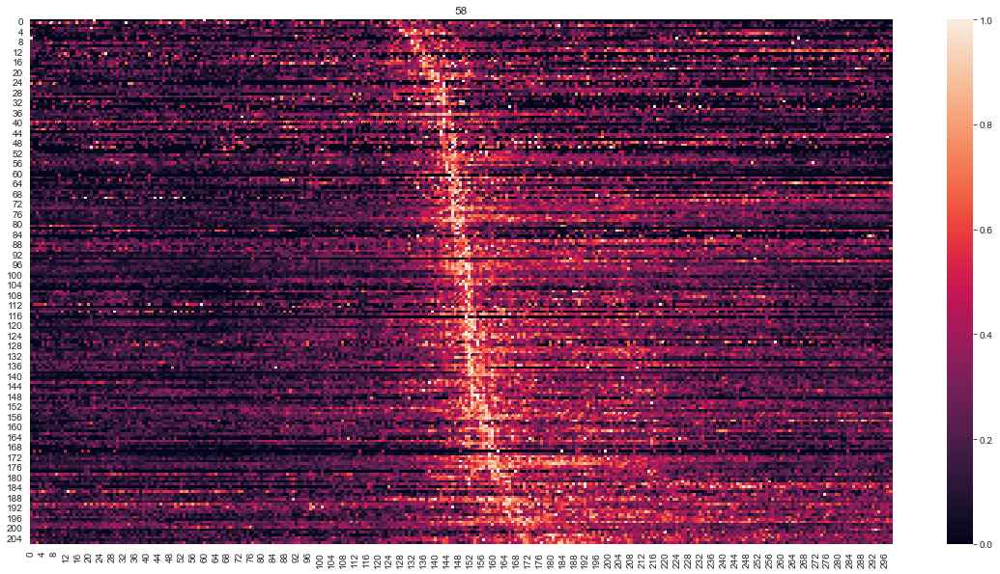

heatmap complete
is this correct? (yes or no) yes
mouse: 49
number of timestamps: (1171390,)
remove odd indices? (yes or no) yes
removed odd indices
aligned
plotting heatmap to confirm
creating heatmap for 49.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


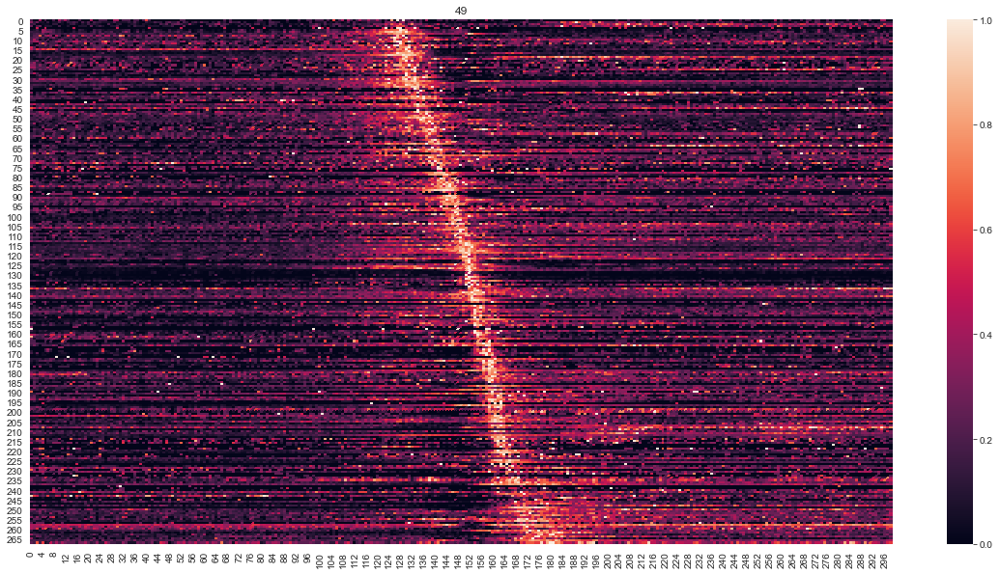

heatmap complete
is this correct? (yes or no) yes
mouse: 53
number of timestamps: (1083276,)
remove odd indices? (yes or no) yes
removed odd indices
aligned
plotting heatmap to confirm
creating heatmap for 53.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


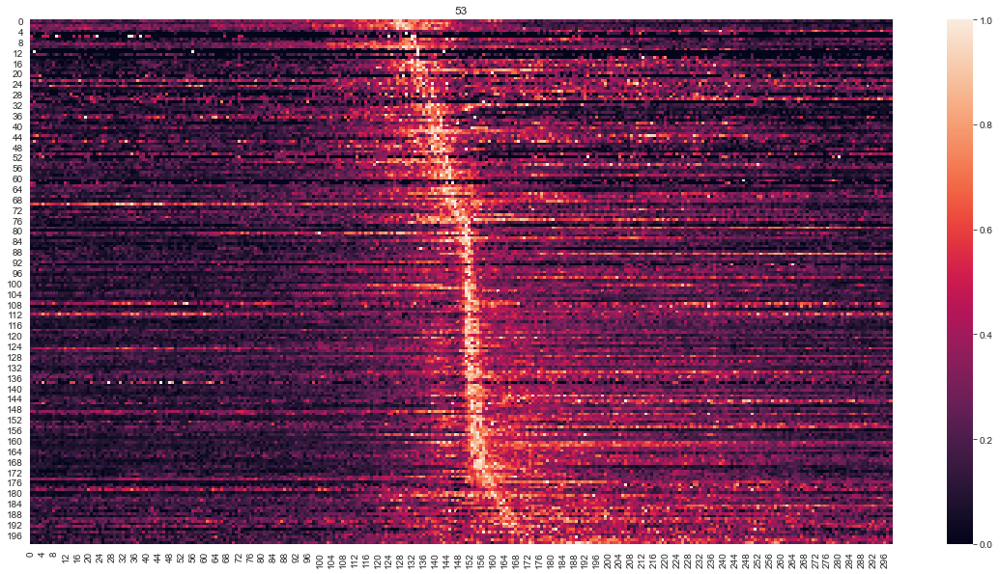

heatmap complete
is this correct? (yes or no) yes
mouse: 56
number of timestamps: (1083244,)
remove odd indices? (yes or no) yes
removed odd indices
aligned
plotting heatmap to confirm
creating heatmap for 56.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


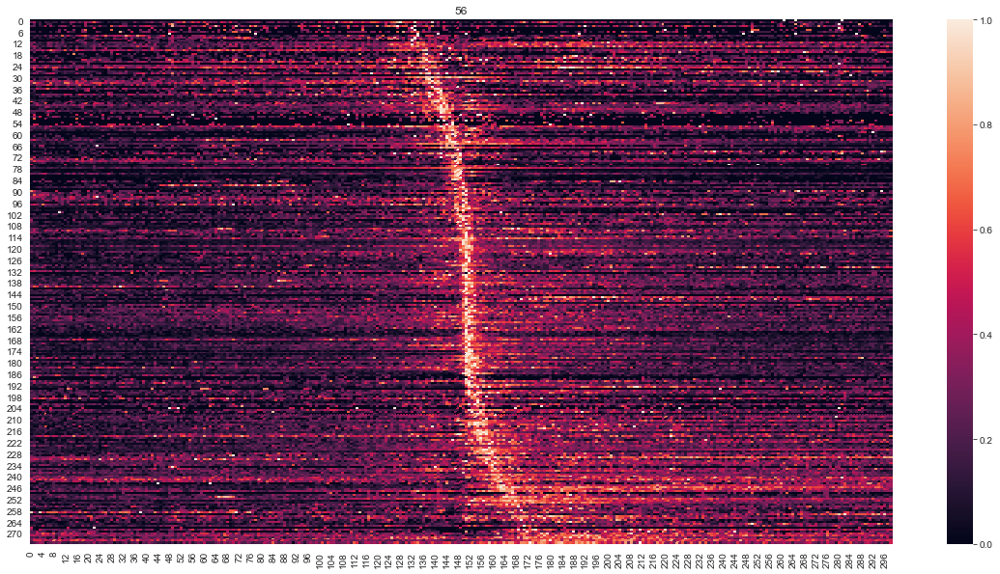

heatmap complete
is this correct? (yes or no) yes
mouse: 63
number of timestamps: (834920,)
remove odd indices? (yes or no) yes
removed odd indices
aligned
plotting heatmap to confirm
creating heatmap for 63.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


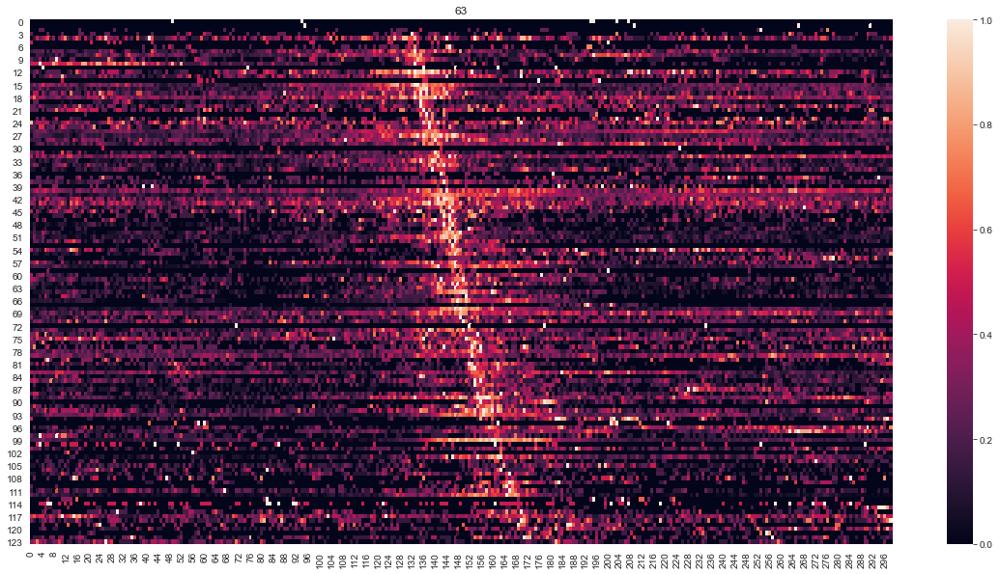

heatmap complete
is this correct? (yes or no) yes
mouse: 66
number of timestamps: (829312,)
remove odd indices? (yes or no) yes
removed odd indices
aligned
plotting heatmap to confirm
creating heatmap for 66.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


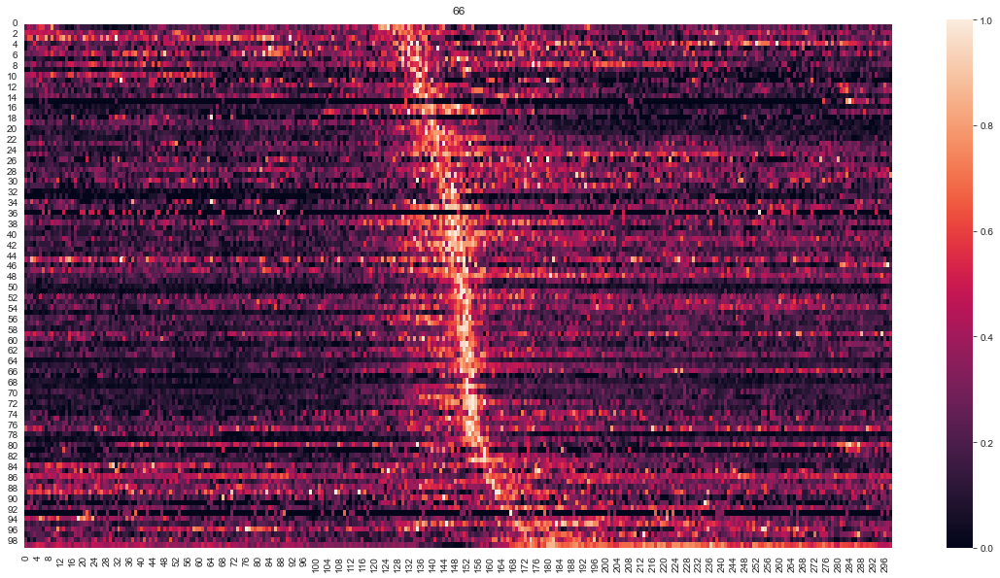

heatmap complete
is this correct? (yes or no) yes
mouse: 69
number of timestamps: (1079198,)
remove odd indices? (yes or no) yes
removed odd indices
aligned
plotting heatmap to confirm
creating heatmap for 69.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


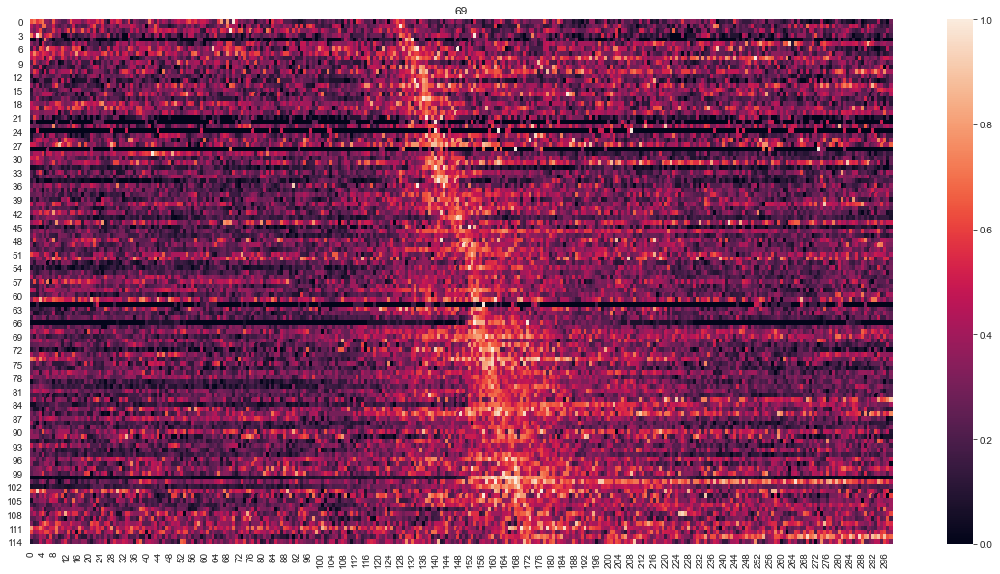

heatmap complete
is this correct? (yes or no) yes
mouse: 68
number of timestamps: (1070245,)
remove odd indices? (yes or no) yes
removed odd indices
aligned
plotting heatmap to confirm
creating heatmap for 68.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


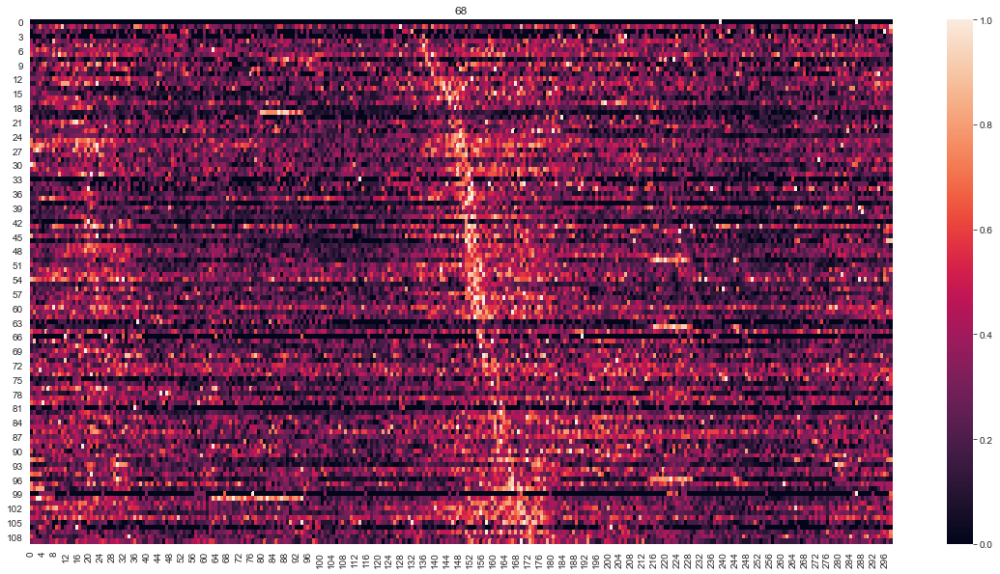

heatmap complete
is this correct? (yes or no) yes
mouse: 70
number of timestamps: (1050448,)
remove odd indices? (yes or no) no
aligned
plotting heatmap to confirm
creating heatmap for 70.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


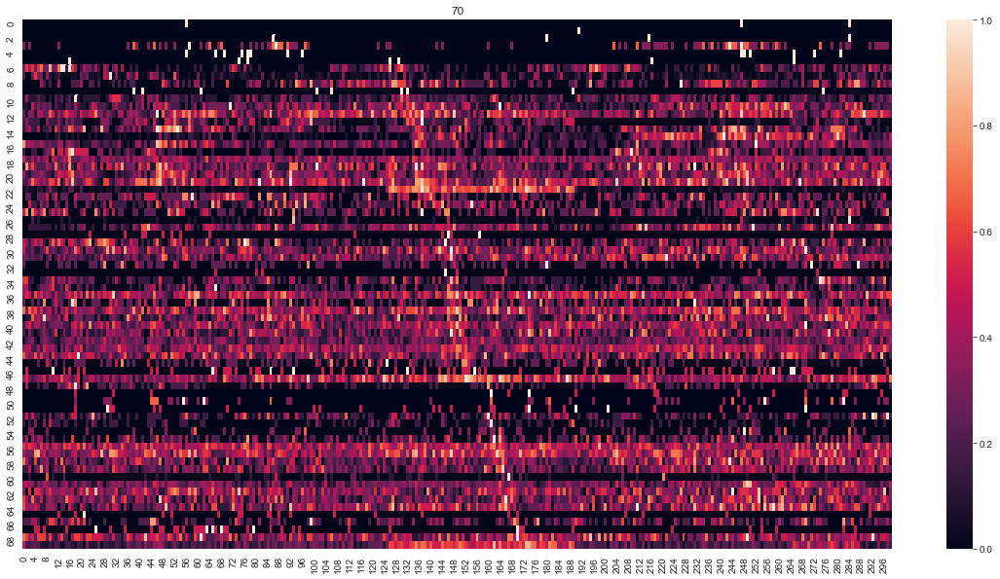

heatmap complete
is this correct? (yes or no) yes
mouse: 64
number of timestamps: (1083048,)
remove odd indices? (yes or no) yes
removed odd indices
aligned
plotting heatmap to confirm
creating heatmap for 64.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


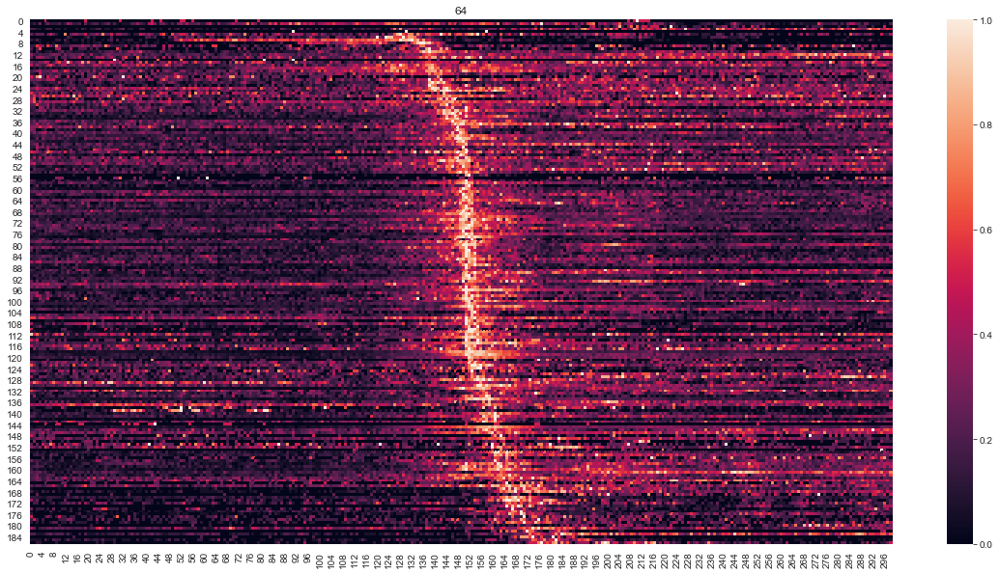

heatmap complete
is this correct? (yes or no) yes
mouse: 71
number of timestamps: (1083040,)
remove odd indices? (yes or no) yes
removed odd indices
aligned
plotting heatmap to confirm
creating heatmap for 71.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


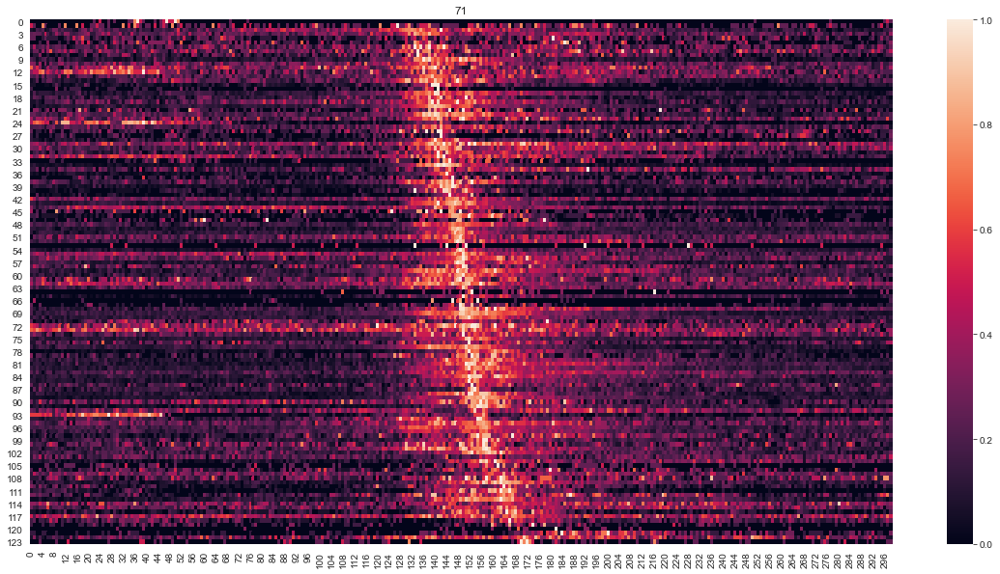

heatmap complete
is this correct? (yes or no) yes
mouse: 65
number of timestamps: (1082948,)
remove odd indices? (yes or no) yes
removed odd indices
aligned
plotting heatmap to confirm
creating heatmap for 65.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


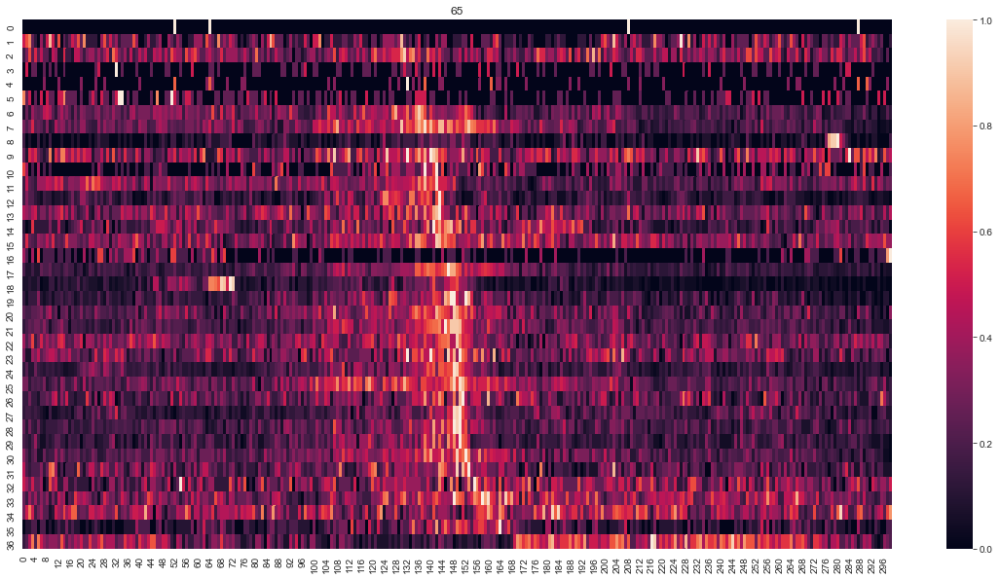

heatmap complete
is this correct? (yes or no) yes
mouse: 67
number of timestamps: (1083024,)
remove odd indices? (yes or no) yes
removed odd indices
aligned
plotting heatmap to confirm
creating heatmap for 67.....
only plotting units that are MODULATED UP....
                 movement modulated units found
plotting heatmap


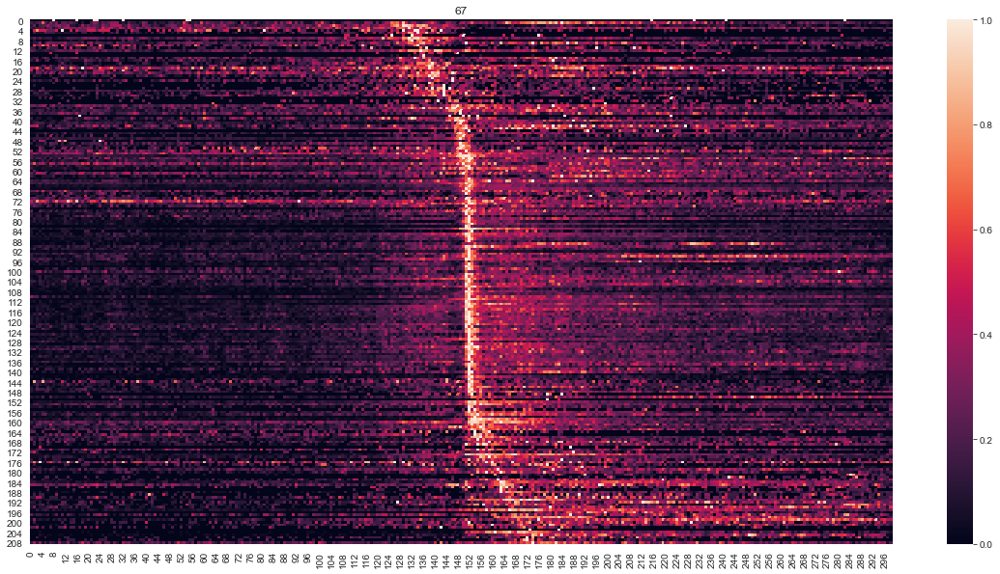

heatmap complete
is this correct? (yes or no) yes


In [172]:
# timeframe and binsize for heatmap hardcoded in batch_synch_phys 

#CURRENTLY: PLOTS ALL MUA AND GOOD LABELED UNITS AND ONLY UNITS THAT ARE MODULATED UP 
dfs = [analysis.batch_synch_phys(df,df_start,df_reaches,df_timestamps,mouseid,inputs=True) for mouseid in df_reaches.mouse.unique()]
df_reaches = pd.concat(dfs,ignore_index=True)

creating heatmap for 11.....
movement modulated units found
plotting heatmap


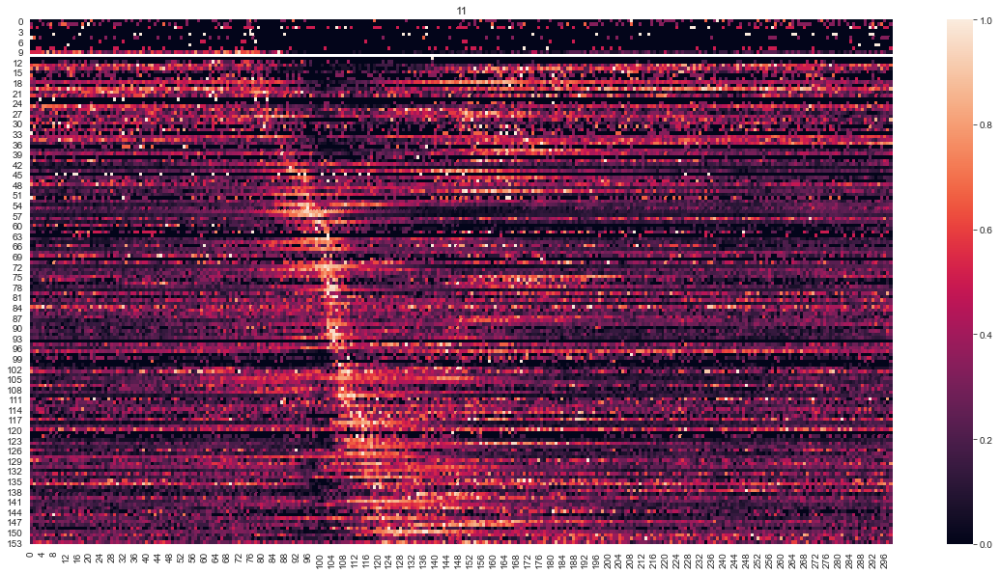

creating heatmap for 12.....
movement modulated units found
plotting heatmap


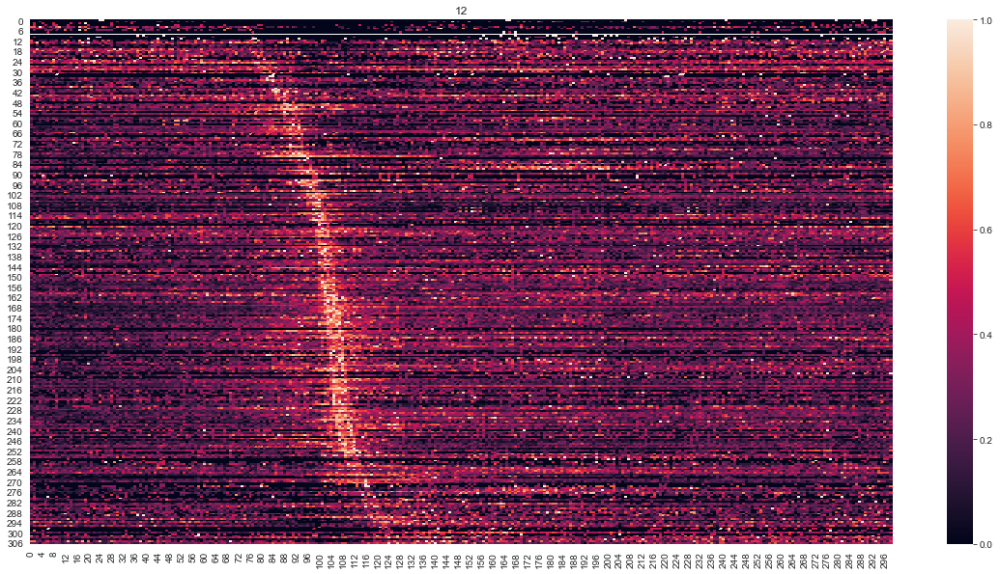

creating heatmap for 22.....
movement modulated units found
plotting heatmap


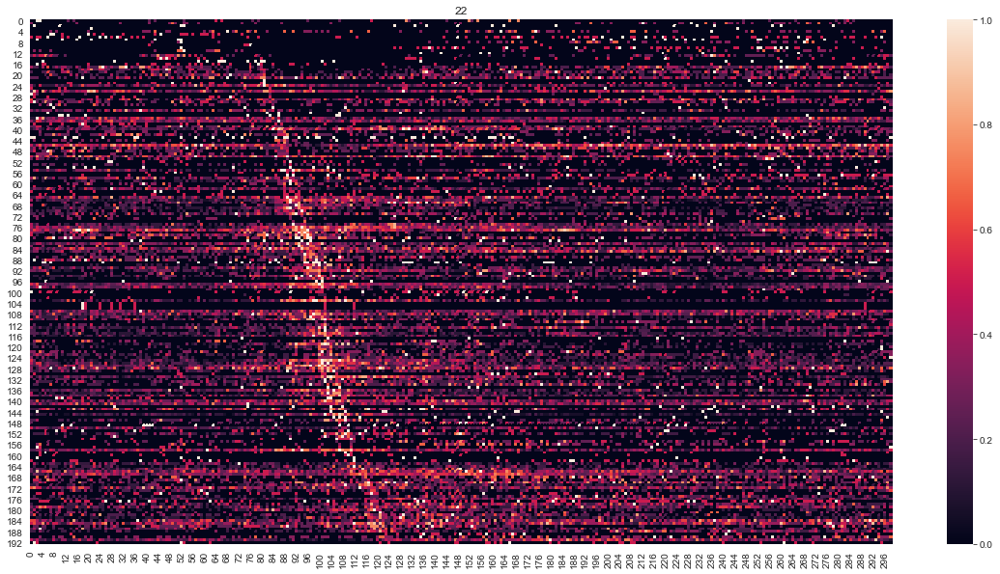

creating heatmap for 24.....
movement modulated units found
plotting heatmap


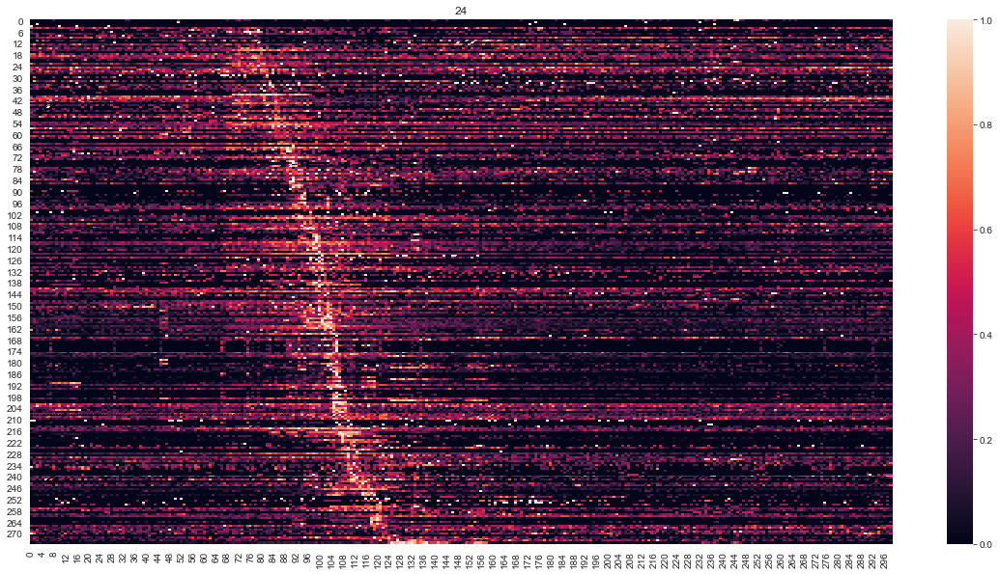

creating heatmap for 19.....
movement modulated units found
plotting heatmap


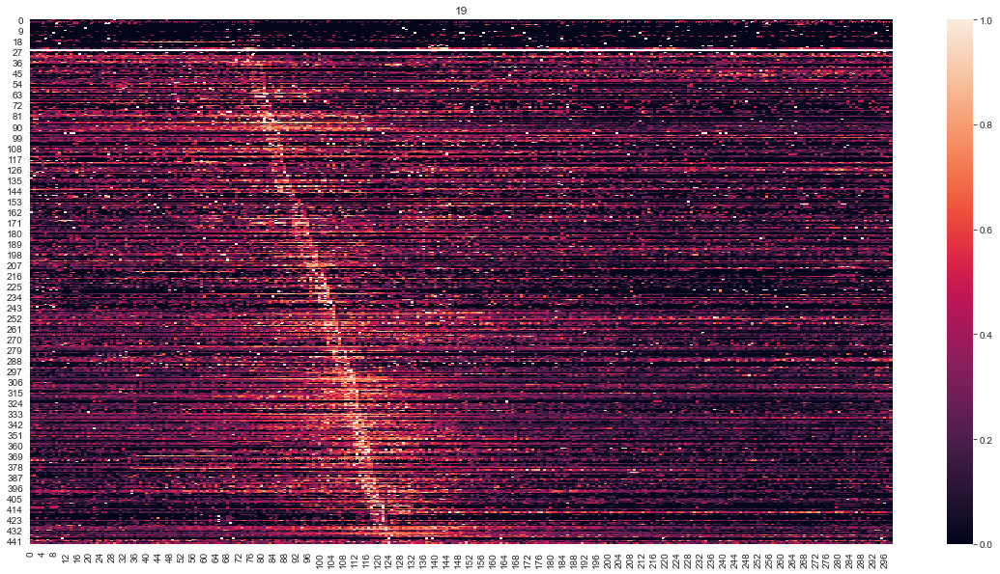

creating heatmap for 20.....
movement modulated units found
plotting heatmap


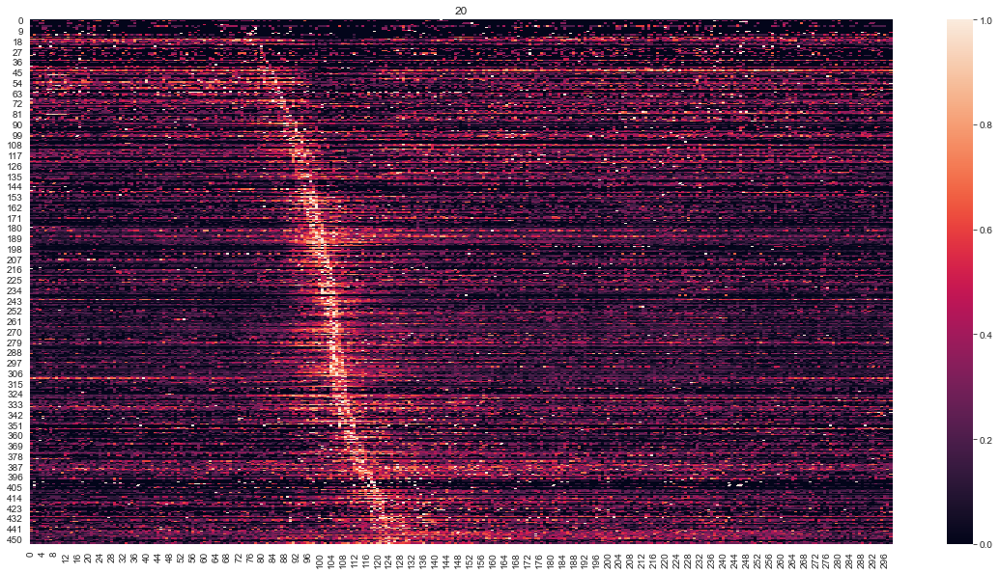

creating heatmap for 26.....
movement modulated units found
plotting heatmap


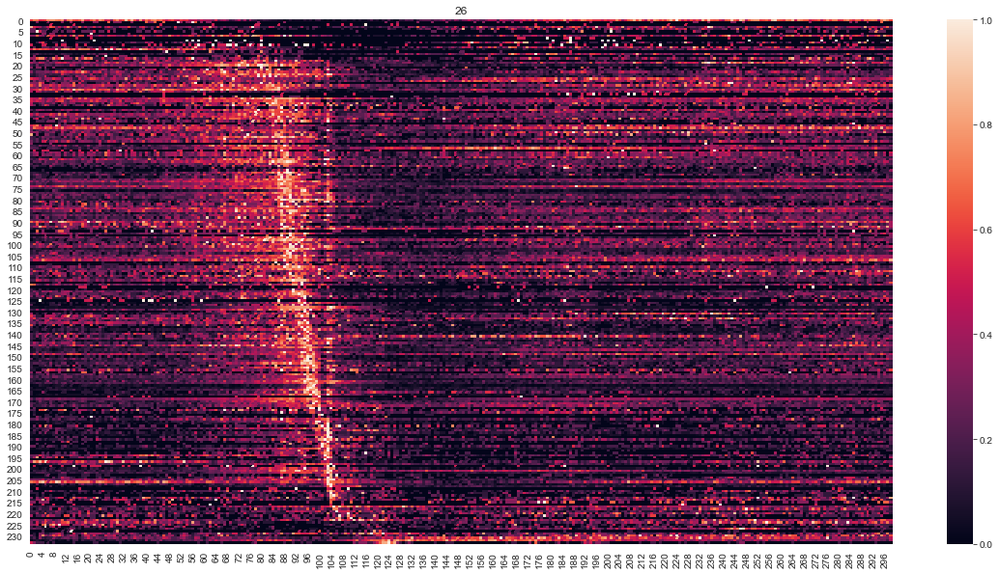

creating heatmap for 28.....
movement modulated units found
plotting heatmap


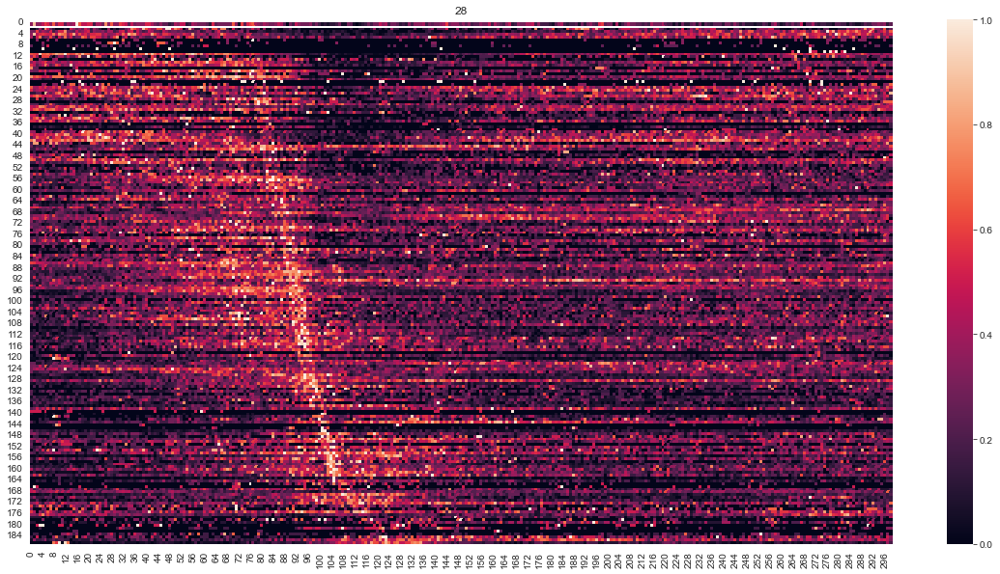

creating heatmap for 42.....
movement modulated units found
plotting heatmap


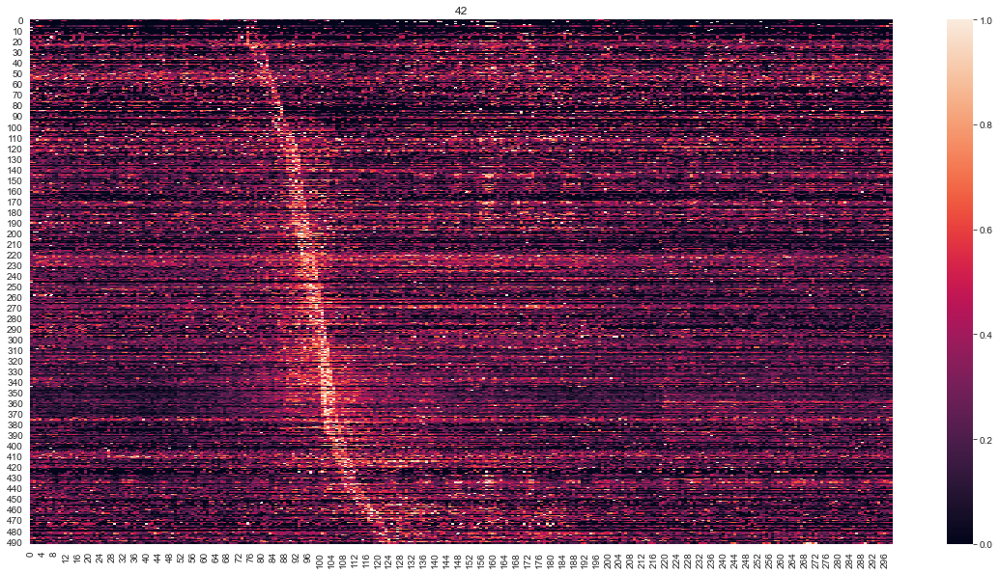

creating heatmap for 43.....
movement modulated units found
movement modulation units not found mouse 43
creating heatmap for 50.....
movement modulated units found
movement modulation units not found mouse 50
creating heatmap for 51.....
movement modulated units found
plotting heatmap


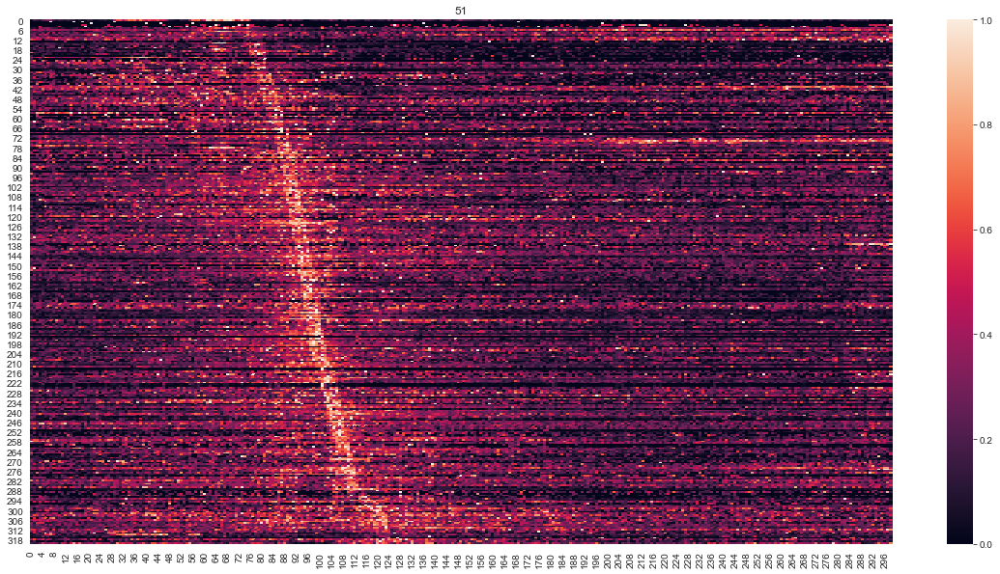

creating heatmap for 47.....
movement modulated units found
plotting heatmap


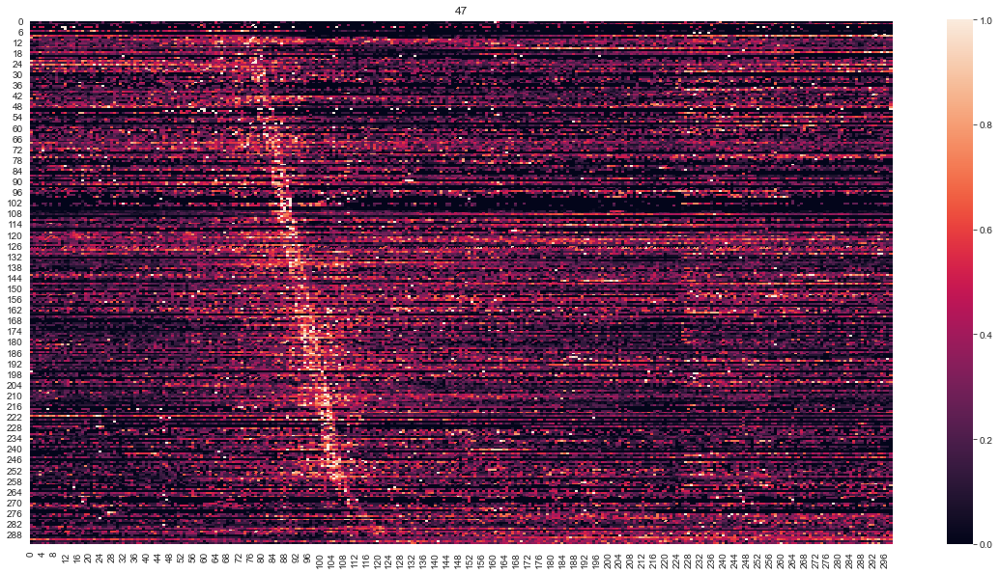

creating heatmap for 59.....
movement modulated units found
plotting heatmap


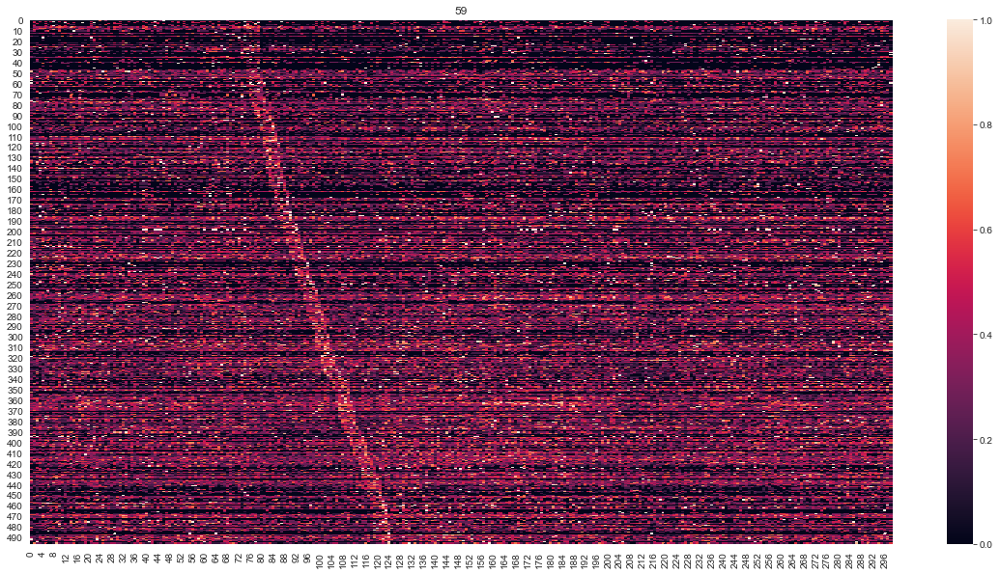

creating heatmap for 58.....
movement modulated units found
plotting heatmap


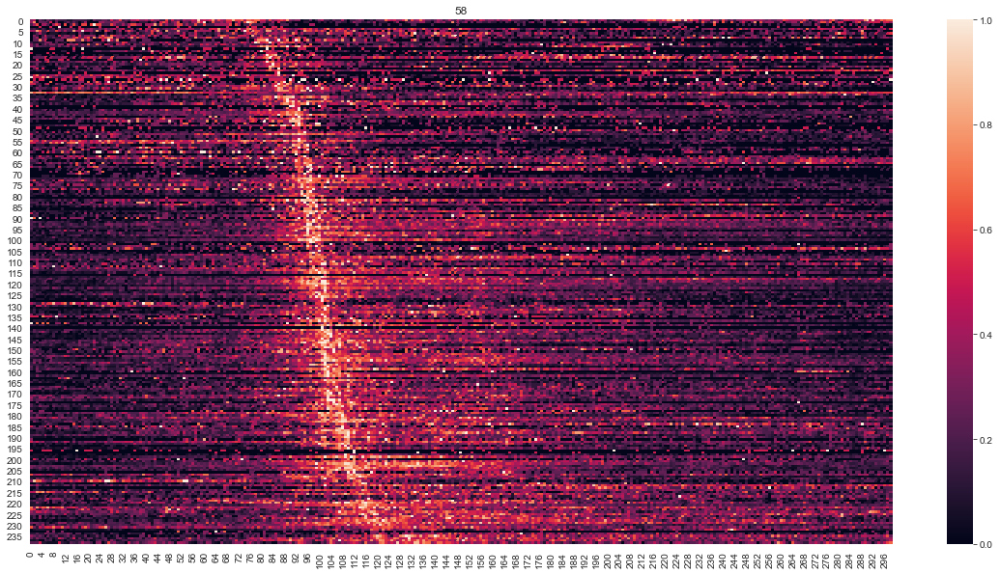

creating heatmap for 49.....
movement modulation units not found mouse 49
creating heatmap for 53.....
movement modulated units found
plotting heatmap


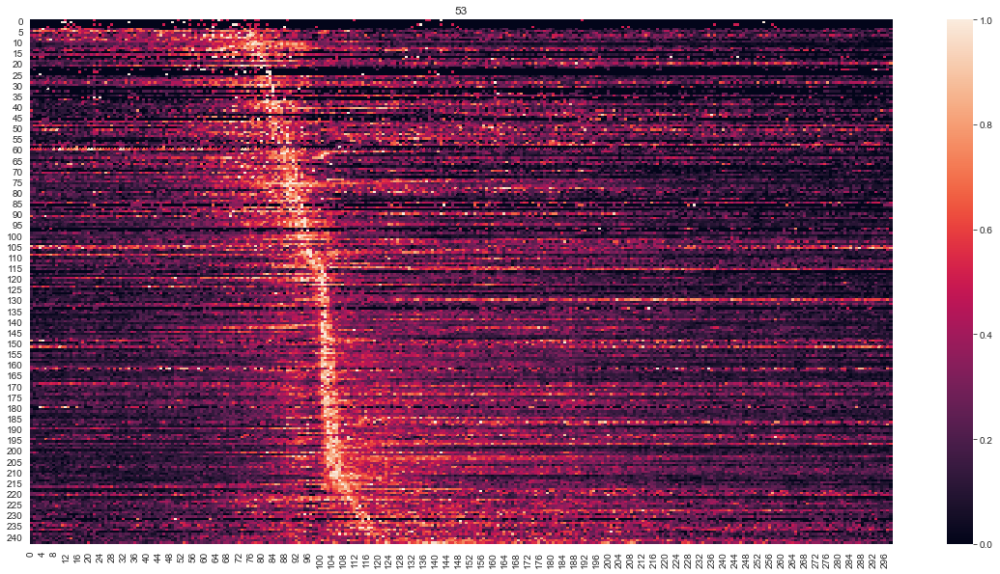

creating heatmap for 56.....
movement modulated units found
plotting heatmap


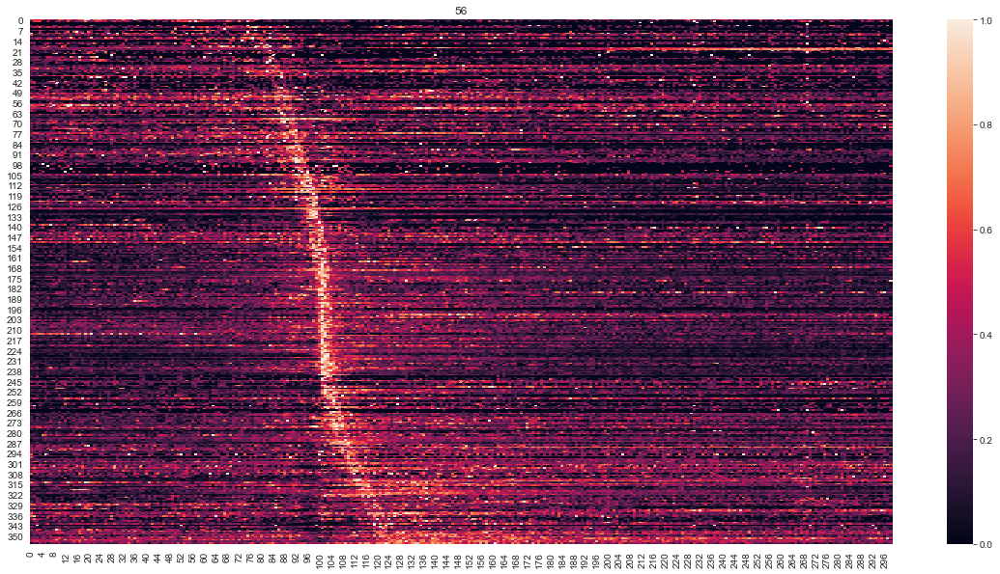

creating heatmap for 63.....
movement modulated units found
plotting heatmap


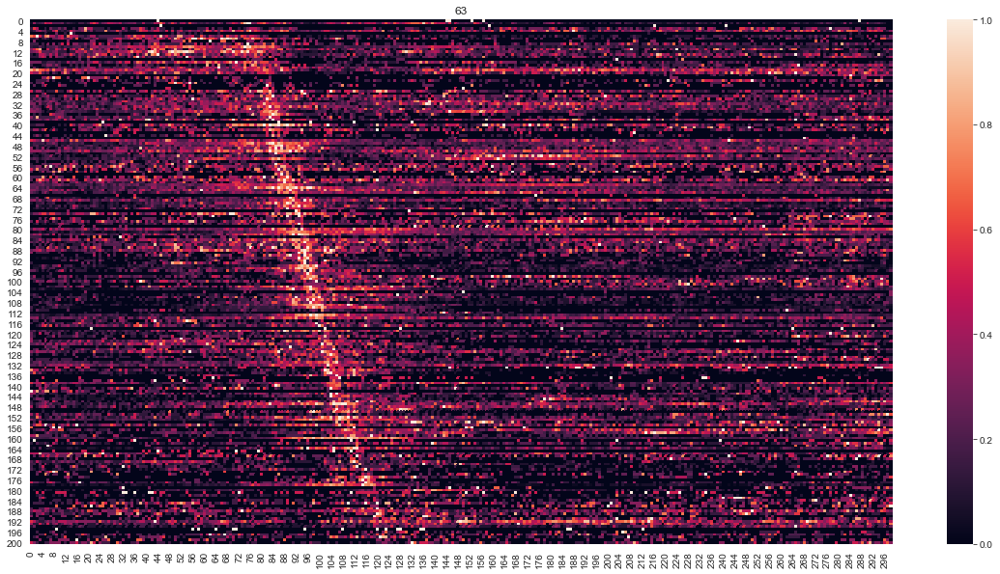

creating heatmap for 66.....
movement modulated units found
plotting heatmap


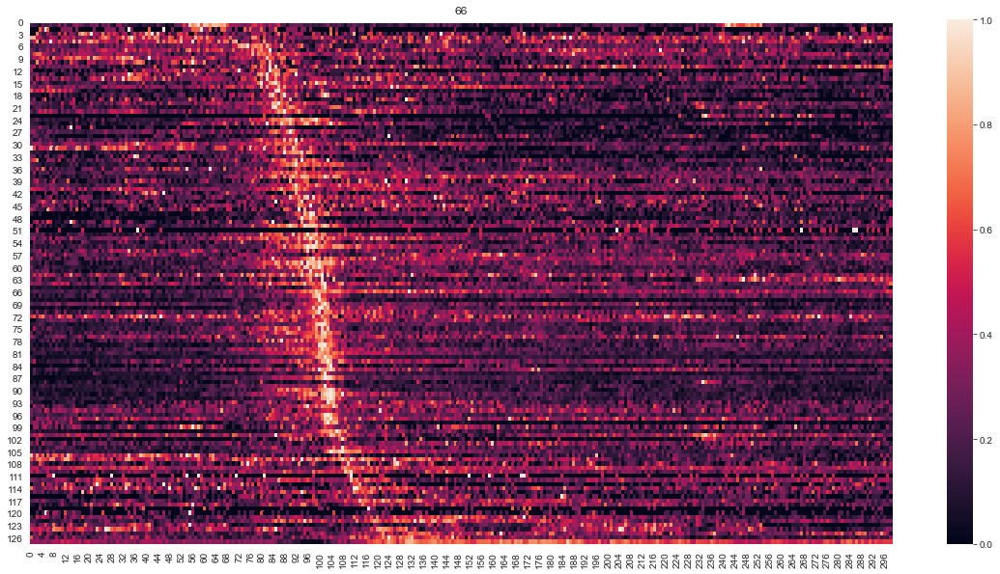

creating heatmap for 69.....
movement modulated units found
plotting heatmap


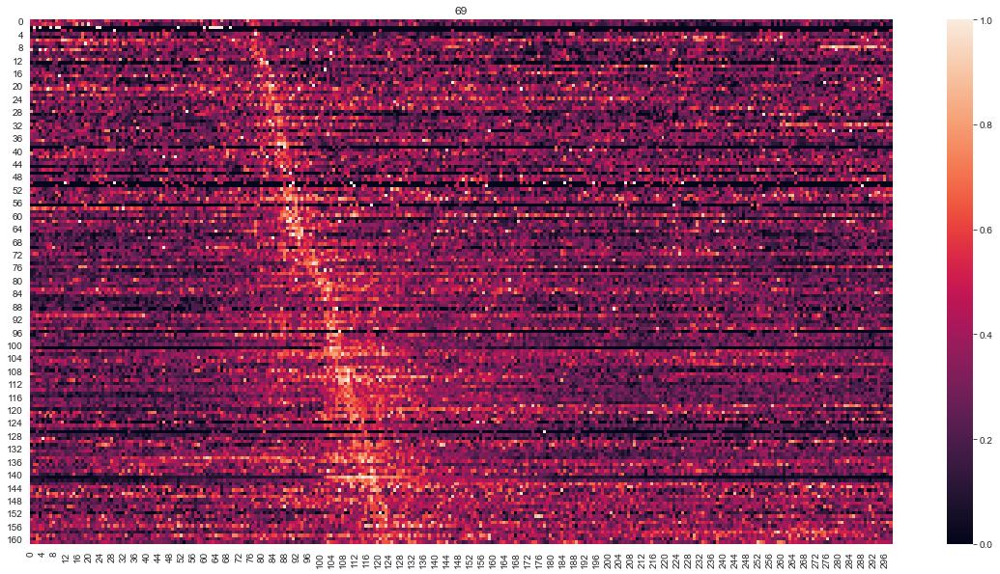

creating heatmap for 68.....
movement modulated units found
plotting heatmap


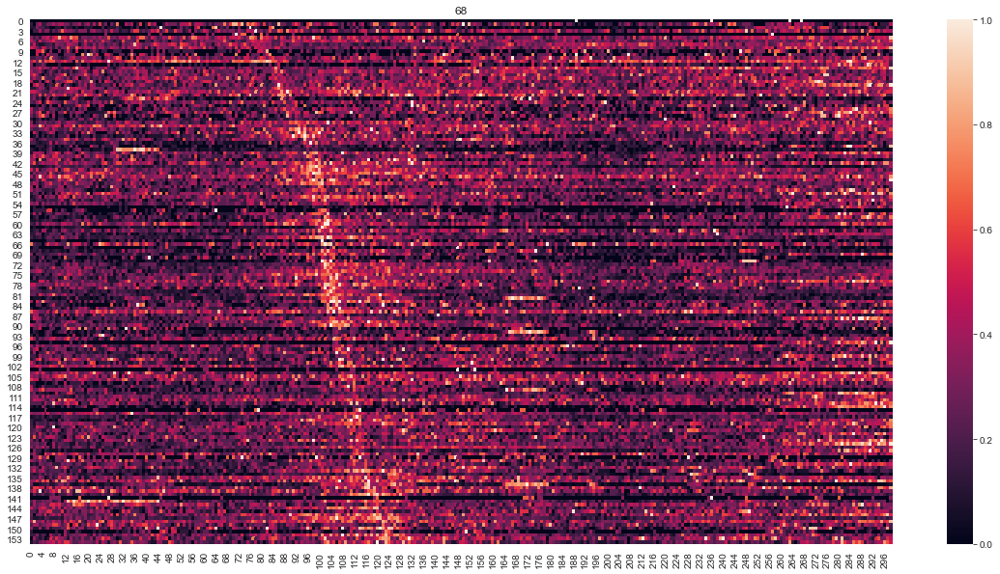

creating heatmap for 70.....
movement modulated units found
plotting heatmap


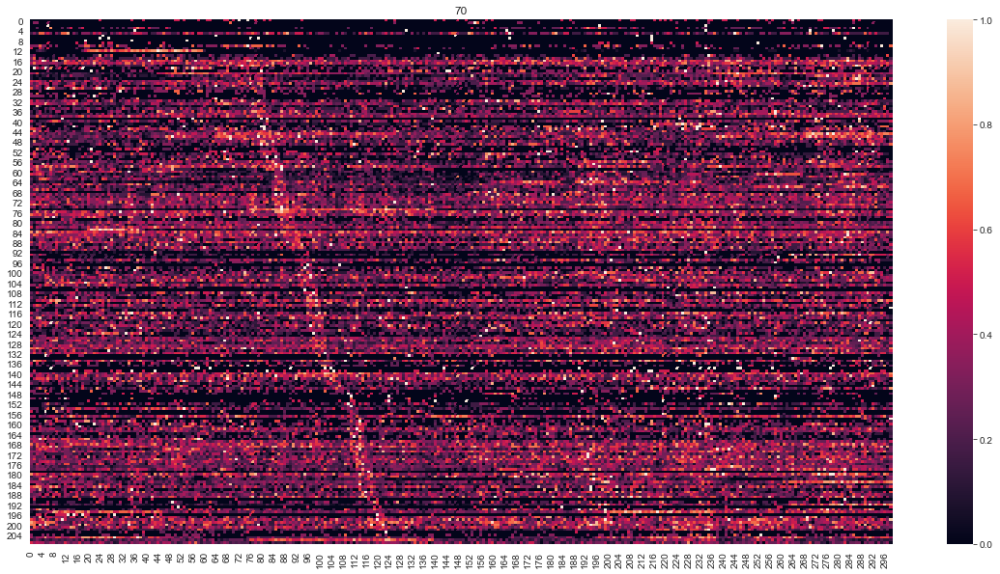

creating heatmap for 64.....
movement modulated units found
plotting heatmap


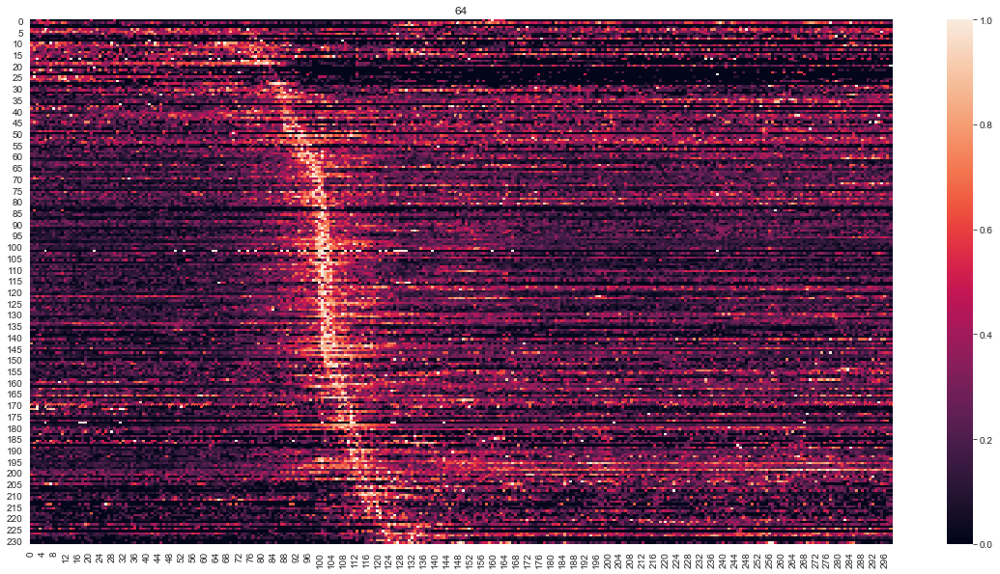

creating heatmap for 71.....
movement modulated units found
plotting heatmap


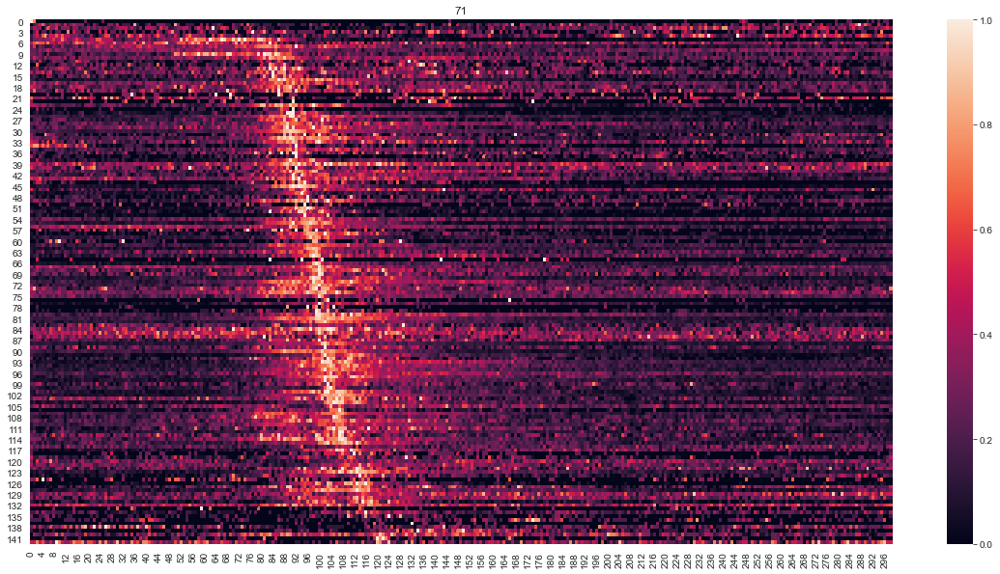

creating heatmap for 65.....
movement modulated units found
plotting heatmap


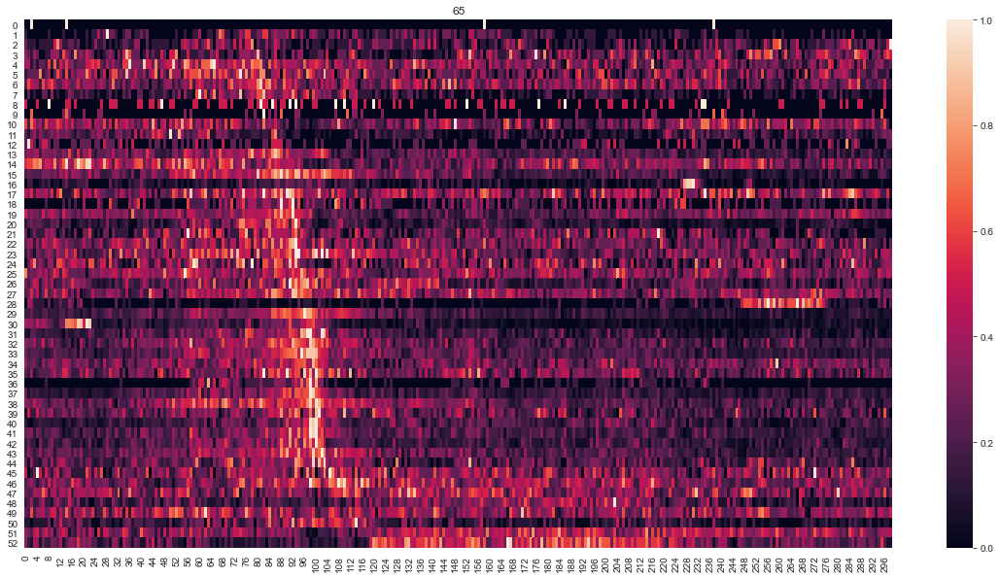

creating heatmap for 67.....
movement modulated units found
plotting heatmap


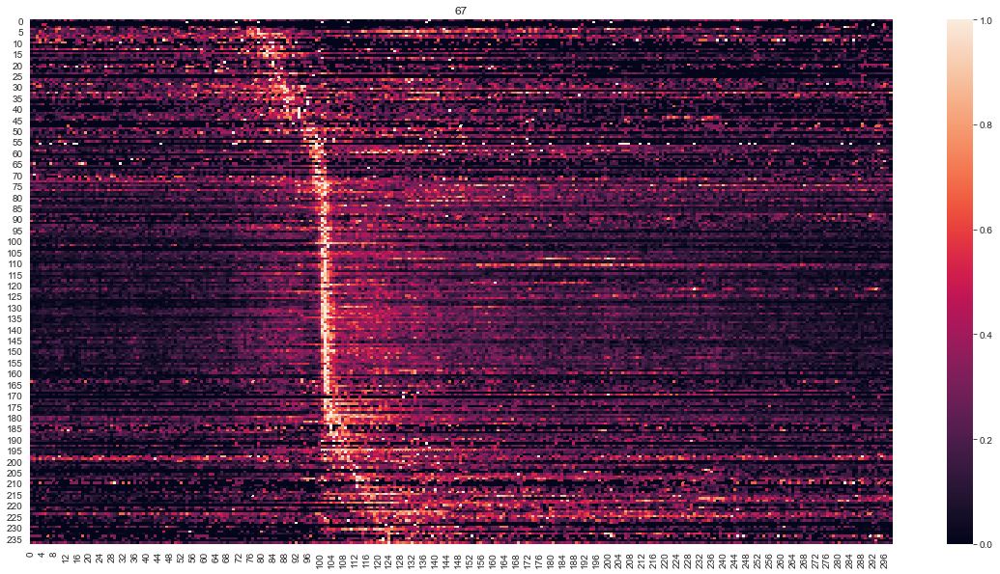

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [14]:
# to add:
    # plot only 'good'
    # plot modulated down units

[analysis.trial_ave_heatmap(df,df_reaches,mouseid,binsize=0.020, start = -2.0,end = 4.0) for mouseid in df_reaches.mouse.unique()]

In [16]:
# change cohort name for specific mice
df['cohort'][df.mouse== 11] = 'Control 1'
df['cohort'][df.mouse== 12] = 'Control 1'
df['cohort'][df.mouse== 20] = 'Demyelinated'
df['cohort'][df.mouse== 26] = 'Remyelination'
df['cohort'][df.mouse== 28] = 'Control 3'
df['cohort'][df.mouse== 42] = 'Control 1'
df['cohort'][df.mouse== 43] = 'Control 1'
df['cohort'][df.mouse== 47] = 'Control 1'
df['cohort'][df.mouse== 49] = 'Control 2'
df['cohort'][df.mouse== 50] = 'Control 1'
df['cohort'][df.mouse== 51] = 'Control 1'
df['cohort'][df.mouse== 53] = 'Demyelinated'
df['cohort'][df.mouse== 56] = 'Control 2'
df['cohort'][df.mouse== 58] = 'Control 2'
df['cohort'][df.mouse== 59] = 'Control 2'
df['cohort'][df.mouse== 63] = 'Demyelinated' #_________
df['cohort'][df.mouse== 64] = 'Remyelination' #_________
df['cohort'][df.mouse== 65] = 'Control 3'
df['cohort'][df.mouse== 66] = 'Demyelinated' #^^
df['cohort'][df.mouse== 68] = 'Remyelination' ##
df['cohort'][df.mouse== 69] = 'Demyelinated' #__________
df['cohort'][df.mouse== 70] = 'Remyelination' ##
df['cohort'][df.mouse== 71] = 'Remyelination' #__________

In [300]:
df_align['cohort'][df_align.mouse== 66] = 'Demyelinated'

# save stuff

In [175]:
df_reaches.to_json(r'C:\Users\16623\Desktop\kim_analysis\kimcode_02.2020\PIPELINE\df_reaches_aligned_092621.json') 

df_reaches.to_csv(r'C:\Users\16623\Desktop\kim_analysis\kimcode_02.2020\PIPELINE\df_reaches_aligned_092621.csv')


In [176]:
df.to_json(r'C:\Users\16623\Desktop\kim_analysis\kimcode_02.2020\PIPELINE\df_all_mice_09_24_21.json')

df.to_csv(r'C:\Users\16623\Desktop\kim_analysis\kimcode_02.2020\PIPELINE\df_all_mice_09_24_21.csv')


In [127]:
import pandas as pd
read_file = pd.read_csv (r'C:\Users\16623\Desktop\kim_analysis\kimcode_02.2020\PIPELINE\df_all_mice_09_23_21.csv')
read_file.to_excel (r'C:\Users\16623\Desktop\kim_analysis\kimcode_02.2020\PIPELINE\df_all_mice_09_23_21.xlsx', index = None, header=True)

ModuleNotFoundError: No module named 'openpyxl'

# depth histograms 

AttributeError: 'DataFrame' object has no attribute 'ypos'

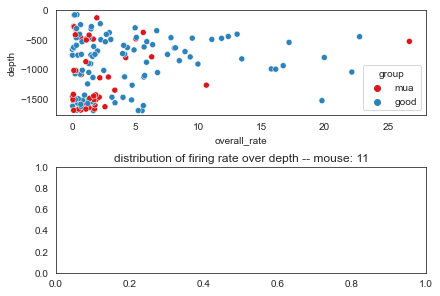

In [17]:
for mouseid in df.mouse.unique():
    df_ = df[df.mouse==mouseid]
    df_ = df_[df_.waveform_class!='up'][df_.waveform_class!='axon']
    
    #ylim = np.max(df_.depth)+100
    #df_ = df_[df_.group=='good']
    fig, (ax1,ax2) = plt.subplots(2,constrained_layout=True)

    g1 = sns.scatterplot(x = df_.overall_rate,
                        y = df_.depth,
                        hue = df_.group, 
                        palette={'mua': '#d7191c','good': '#2b83ba'},
                         ax = ax1)
                     #ylim = [ylim,-100])  
    plt.title('distribution of firing rate over depth -- mouse: ' + str(mouseid))
    
    g2 = sns.scatterplot(x = df_.overall_rate,
                        y = -1* df_.ypos,
                        hue = df_.group, 
                        palette={'mua': '#d7191c','good': '#2b83ba'},
                         ax = ax2)
                     #ylim = [ylim,-100])  
    plt.title('distribution of firing rate over depth -- mouse: ' + str(mouseid))
    #save_path = r'C:\Users\16623\Desktop\kim_analysis\kimcode_02.2020\PIPELINE'
    
    #plt.savefig(save_path + '\mouse' + str(mouseid)) #CHANGE MOUSE NUMBER BEFORE RUNNING
              
    plt.show()
    plt.close()

In [1]:
df

NameError: name 'df' is not defined

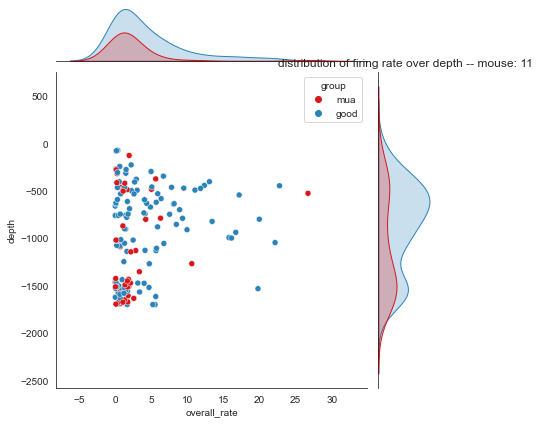

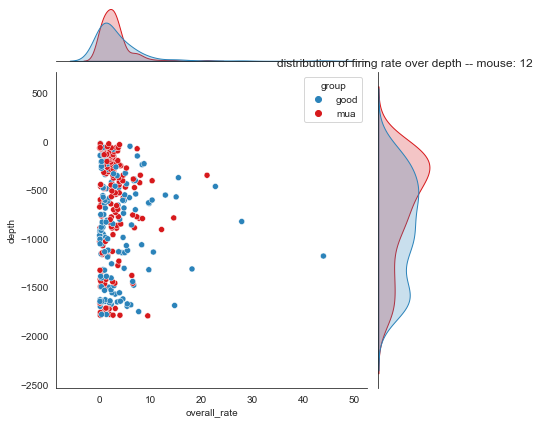

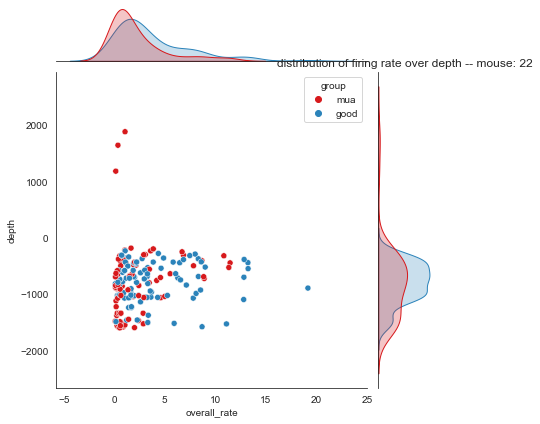

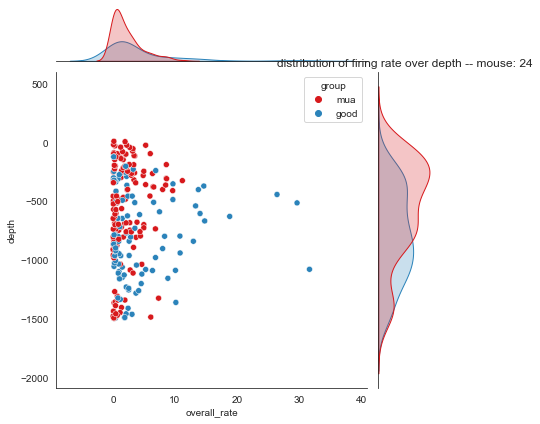

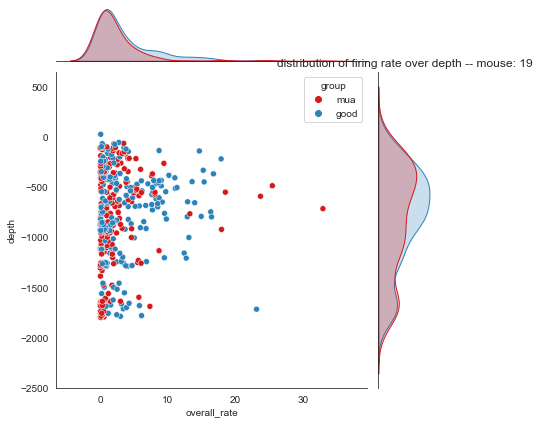

...

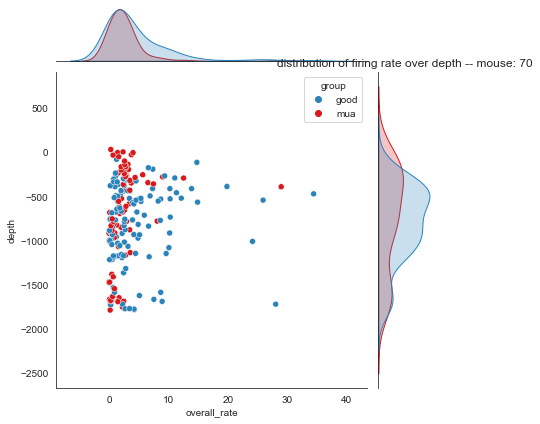

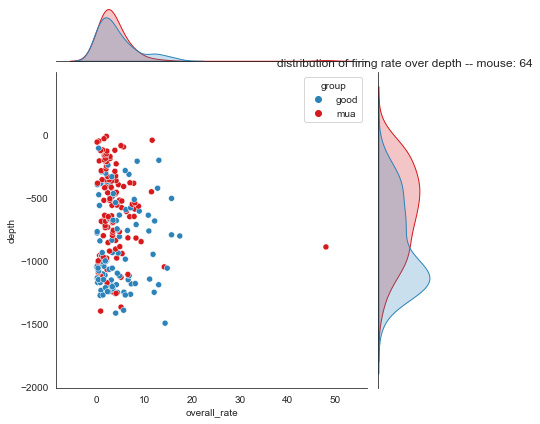

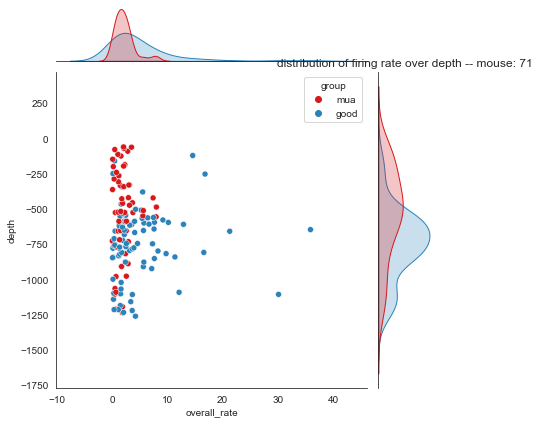

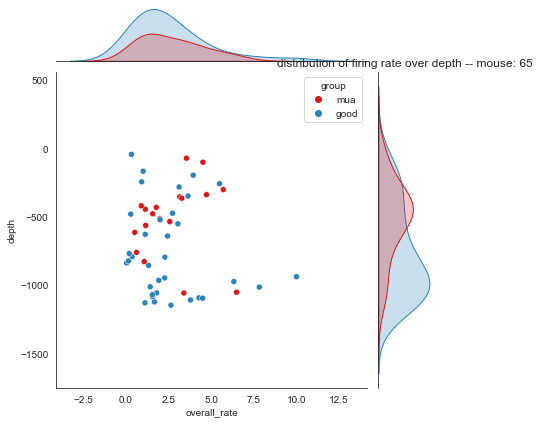

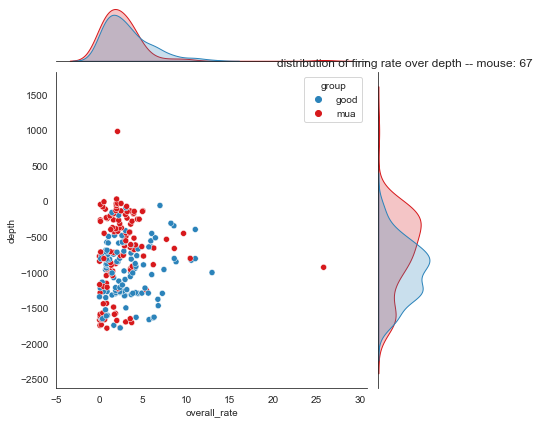

In [181]:
for mouseid in df.mouse.unique():
    df_ = df[df.mouse==mouseid]
    df_ = df_[df_.waveform_class!='up'][df_.waveform_class!='axon']
    
    ylim = np.max(df_.depth)+100
    #df_ = df_[df_.group=='good']
    
    g = sns.jointplot(x = df_.overall_rate,
                        y = df_.depth,
                        hue = df_.group, 
                        palette={'mua': '#d7191c','good': '#2b83ba'}),
                     #ylim = [ylim,-100])  
    plt.title('distribution of firing rate over depth -- mouse: ' + str(mouseid))
    save_path = r'C:\Users\16623\Desktop\kim_analysis\kimcode_02.2020\PIPELINE'
    
    plt.savefig(save_path + '\mouse' + str(mouseid)) #CHANGE MOUSE NUMBER BEFORE RUNNING
              
    plt.show()
    plt.close()

In [159]:
fig = sns.jointplot(x = df.overall_rate,y = df.depth, hue = df.cohort)for mouseid in df.mouse.unique():
    df_ = df[df.mouse==mouseid]
    df_ = df_[df_.waveform_class!='up'][df_.waveform_class!='axon']
    
    ylim = np.max(df_.depth)+100
    #df_ = df_[df_.group=='good']
    
    g = sns.jointplot(x = df_.overall_rate,
                        y = df_.depth,
                        hue = df_.group, 
                        palette={'mua': '#d7191c','good': '#2b83ba'}),
                     #ylim = [ylim,-100])  
    plt.title('distribution of firing rate over depth -- mouse: ' + str(mouseid))
    save_path = r'C:\Users\16623\Desktop\kim_analysis\kimcode_02.2020\PIPELINE'
    
    plt.savefig(save_path + '\mouse' + str(mouseid)) #CHANGE MOUSE NUMBER BEFORE RUNNING
              
    plt.show()
    plt.close()
    
#    g = sns.jointplot(data=penguins, x="bill_length_mm", y="bill_depth_mm")
#g.plot_joint(sns.kdeplot, color="r", zorder=0, levels=6)
#g.plot_marginals(sns.rugplot, color="r", height=-.15, clip_on=False)

#kind = "reg"
    

SyntaxError: invalid syntax (<ipython-input-159-59e64455e577>, line 1)

In [301]:
df_align_ = df_align[df_align.cohort!='NPCH'][df_align.cohort!='NPCD'][df_align.group=='good']

(0.0, 100.0)

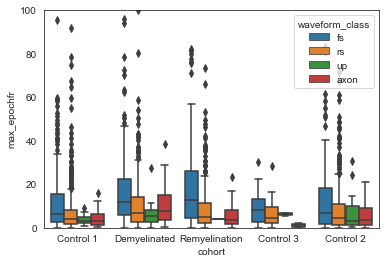

In [319]:
sns.boxplot(x=df_align_.cohort,y=df_align.max_epochfr,hue=df_align_.waveform_class)
plt.ylim(0,100)

(0.0, 20.0)

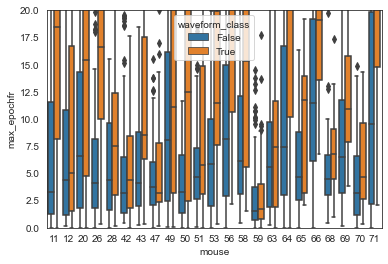

In [316]:
sns.boxplot(x=df_align_.mouse,y=df_align.max_epochfr,hue=df_align_.waveform_class=='fs')

plt.ylim(0,20)

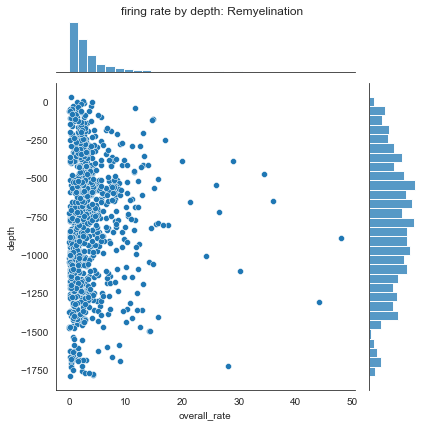

In [254]:
df_temp = df[df.cohort=='Remyelination'].reset_index()
p = sns.jointplot(x = df_temp.overall_rate,y = df_temp.depth,marginal_kws=dict(bins=30, rug=True))
cohort = df_temp.cohort[0]
p.fig.suptitle('firing rate by depth: ' + str(cohort))
p.fig.tight_layout()
p.fig.subplots_adjust(top=0.95) # Reduce plot to make room 
save_path = r'C:\Users\16623\Desktop\kim_analysis\kimcode_02.2020\PIPELINE\Firing_rate_by_depth'
p.savefig(os.path.join(save_path, str(cohort) + '.png'))

In [268]:

[analysis.trial_ave_heatmap(df,df_reaches,cohort,binsize=0.020, start = -2.0,end = 4.0) for cohort in enumerate(df.cohort.unique())]



per mouse or cohort? (enter mouse or cohortcohort


NameError: name 'mouseid' is not defined

In [266]:
df_temp = df[df.cohort=='Demyelinated'].reset_index()
p = sns.jointplot(x = df_temp.overall_rate,y = df_temp.depth,hue=df_temp.group,marginal_kws=dict(bins=30, rug=True))
cohort = df_temp.cohort[0
p.fig.suptitle('firing rate by depth: ' + str(cohort))
p.fig.tight_layout()
p.fig.subplots_adjust(top=0.95) # Reduce plot to make room 
save_path = ''
fig.savefig(save_path+'firing rate by depth: ' + str(cohort) + '.png')

SyntaxError: invalid syntax (<ipython-input-266-741a1501141c>, line 4)

# align data to reach epochs 

get reach epoch and baseline firing rates
assign movement modulated units

In [270]:
# create df_align
df_align_all = [analysis.reach_info(df,df_reaches,mouseid) for mouseid in df_reaches.mouse.unique()]
df_align = pd.concat(df_align_all,ignore_index=True)

computing reach epoch info for mouse 11
computing reach epoch info for mouse 12
computing reach epoch info for mouse 22
computing reach epoch info for mouse 24
computing reach epoch info for mouse 19
computing reach epoch info for mouse 20
computing reach epoch info for mouse 26
computing reach epoch info for mouse 28
computing reach epoch info for mouse 42
computing reach epoch info for mouse 43
computing reach epoch info for mouse 50
computing reach epoch info for mouse 51
computing reach epoch info for mouse 47
computing reach epoch info for mouse 59
computing reach epoch info for mouse 58
computing reach epoch info for mouse 49
computing reach epoch info for mouse 53
computing reach epoch info for mouse 56
computing reach epoch info for mouse 63
computing reach epoch info for mouse 66
computing reach epoch info for mouse 69
computing reach epoch info for mouse 68
computing reach epoch info for mouse 70
computing reach epoch info for mouse 64
computing reach epoch info for mouse 71


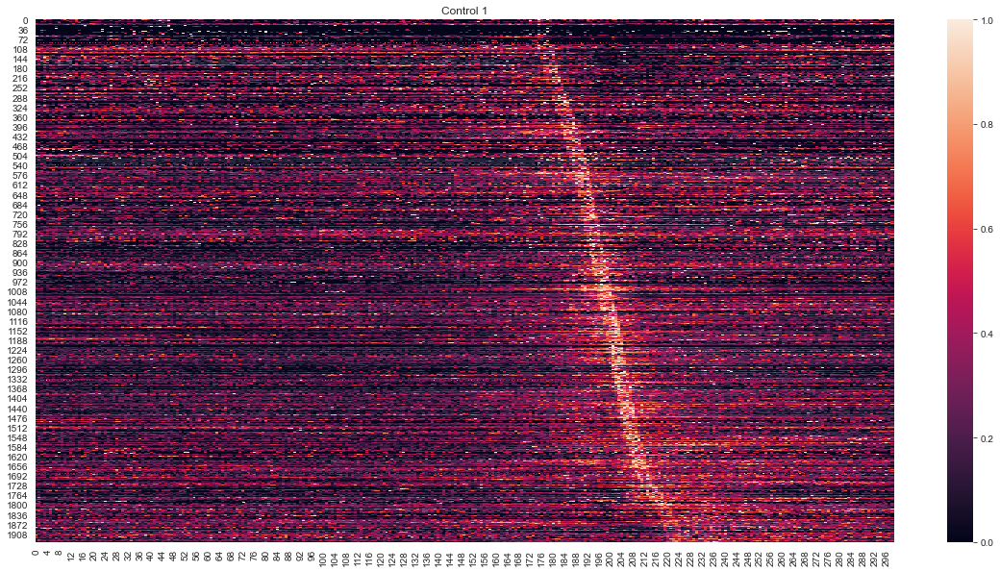

<Figure size 432x288 with 0 Axes>

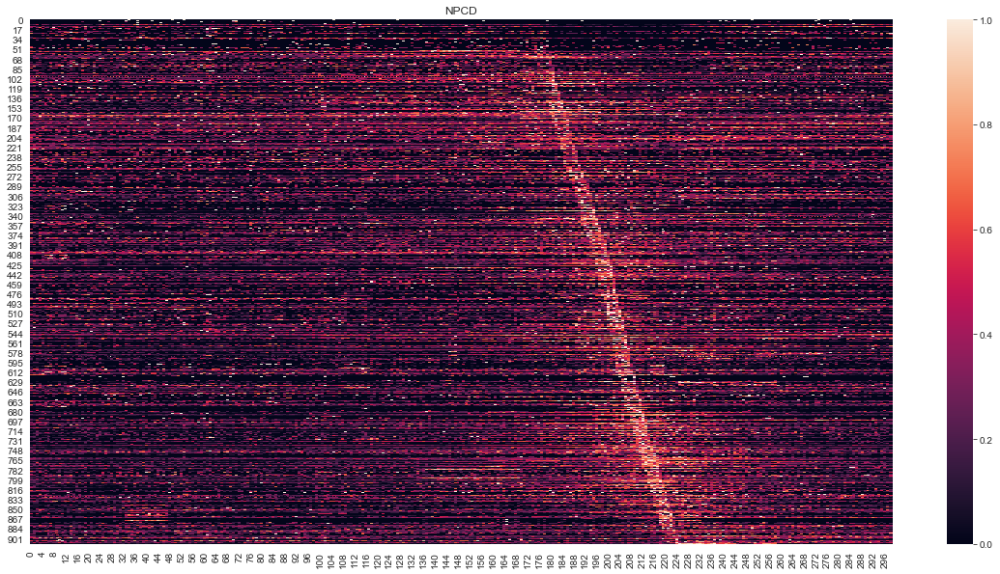

<Figure size 432x288 with 0 Axes>

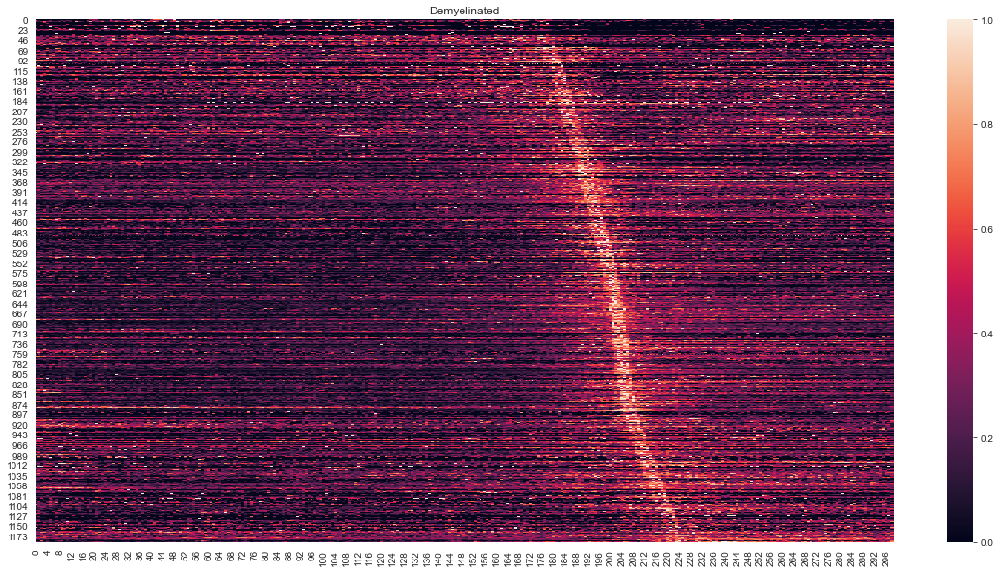

<Figure size 432x288 with 0 Axes>

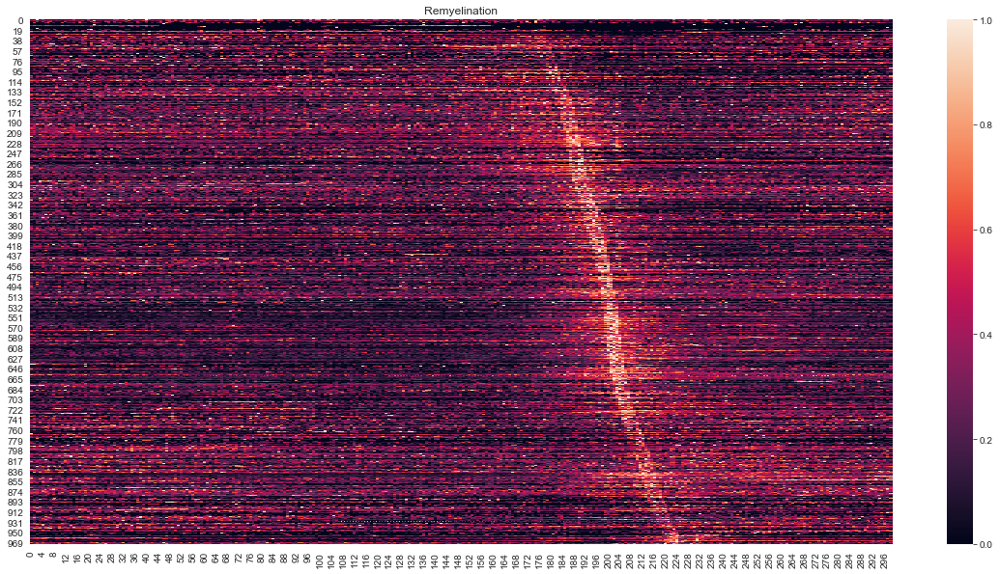

<Figure size 432x288 with 0 Axes>

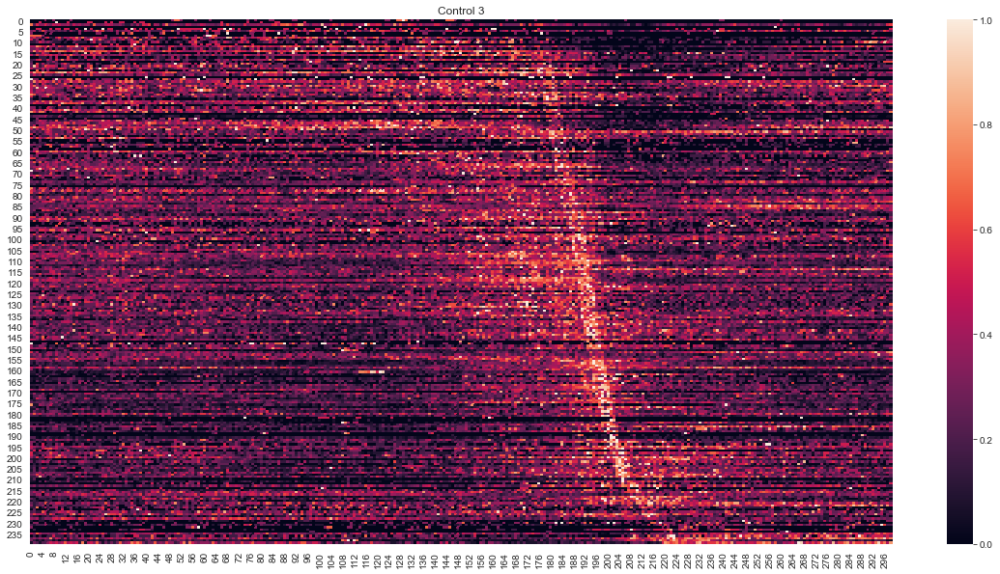

<Figure size 432x288 with 0 Axes>

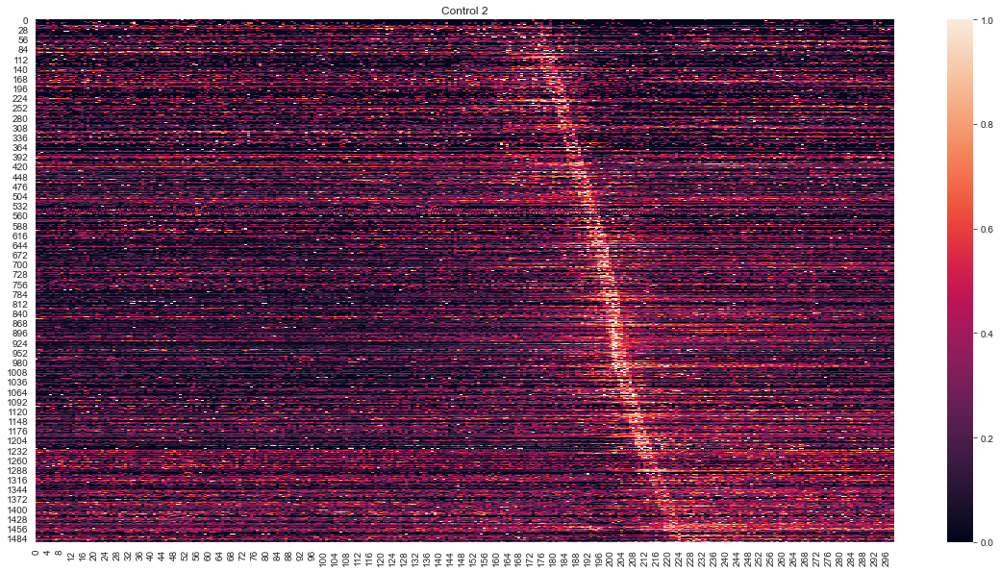

<Figure size 432x288 with 0 Axes>

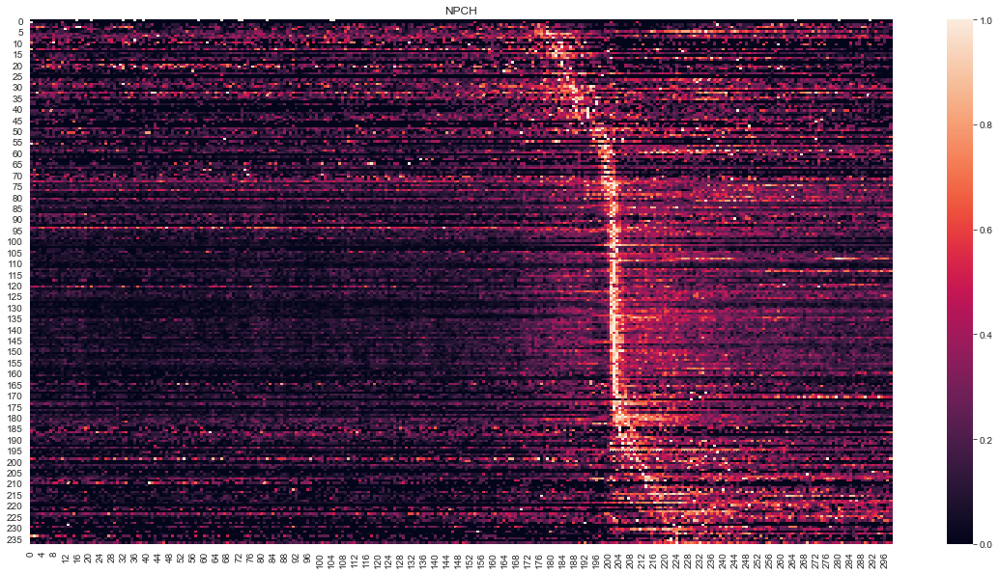

<Figure size 432x288 with 0 Axes>

In [281]:
for i,cohort in enumerate(df.cohort.unique()):
    df_align_ = df[df.cohort==cohort]
    
    df_s= df_align_.sort_values(by=['peakfr_up'])
    df_bins_ = df_s.norm_bin_ave
    df_heatmap = list(filter(any, df_bins_))
    fig, ax = plt.subplots(figsize=(20, 10))
    fig = sns.heatmap(df_heatmap)
    plt.title(str(cohort))
    plt.show()
    plt.close()
    save_path = r'C:\Users\16623\Desktop\kim_analysis\kimcode_02.2020\PIPELINE\Cohort Heatmaps'
    plt.savefig(os.path.join(save_path,str(cohort)+'.png'))
    

In [178]:
# save it
df_align.to_json(r'C:\Users\16623\Desktop\kim_analysis\df_align_09_26_21.json')


df_align = pd.DataFrame(df_align,columns = ['ypos','depth', 'layer','mouse','cohort','group','cell','overall_rate','waveform_class','baseline_fr','reach_fr','mod_up','mod_down','peakfr_up','peakfr_down','max_epochfr','min_epochfr'])
df_align.to_csv(r'C:\Users\16623\Desktop\kim_analysis\kimcode_02.2020\PIPELINE\df_align_09_26_21.csv')

In [283]:
df_r = df[df.cohort=='Remyelination']

In [288]:
df_r[df_r.waveform_class=='rs'][df.group=='good'][df.mouse!=70]

,times,depth,layer,group,mouse,cohort,cell,overall_rate,waveform_class,baseline_fr,reach_fr,bin_ave,norm_bin_ave,mod_up,mod_down,peakfr_up,peakfr_down,max_epochfr,min_epochfr
1830,"[0.7675666667000001, 22.0981666667, 43.4563, 6...",-481.890169,L2-3,good,26,Remyelination,253,1.996007,rs,1.560976,0.756098,"[0.012195122000000001, 0.0365853659, 0.0, 0.0,...","[0.125, 0.375, 0.0, 0.0, 0.25, 0.0, 0.125, 0.5...",no,no,-3.460000e-01,-0.005,4.512195,0.97561
1831,"[21.3335, 21.9616, 21.9693333333, 22.0209, 22....",-497.731106,L2-3,good,26,Remyelination,254,0.584791,rs,0.365854,0.658537,"[0.0243902439, 0.0, 0.0, 0.0, 0.01219512200000...","[0.4, 0.0, 0.0, 0.0, 0.2, 0.0, 0.2, 0.0, 0.4, ...",yes,no,2.280000e-01,-0.231,4.512195,0.97561
1835,"[1.3533666667, 2.9297, 4.9561666667, 5.7140666...",-465.173850,L2-3,good,26,Remyelination,260,3.948235,rs,5.292683,4.878049,"[0.13414634150000002, 0.1219512195, 0.09756097...","[0.5, 0.4444444444, 0.33333333330000003, 0.222...",yes,yes,-2.040000e-01,0.370,4.512195,0.97561
1841,"[0.31070000000000003, 0.31570000000000004, 0.3...",-333.258209,L2-3,good,26,Remyelination,272,0.754223,rs,1.951220,2.890244,"[0.0243902439, 0.0, 0.0, 0.0365853659, 0.02439...","[0.125, 0.0, 0.0, 0.1875, 0.125, 0.0, 0.0625, ...",yes,no,1.350000e-01,0.496,4.512195,0.97561
1844,"[0.1477333333, 0.6311333333, 0.6481, 1.7605, 1...",-294.822214,L2-3,good,26,Remyelination,278,4.870511,rs,8.780488,12.268293,"[0.0731707317, 0.1463414634, 0.1219512195, 0.0...","[0.1818181818, 0.3636363636, 0.303030303, 0.24...",yes,no,-1.620000e-01,0.051,4.512195,0.97561
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6704,"[11.7272, 19.1140333333, 19.1968333333, 19.274...",-758.185326,L5,good,71,Remyelination,265,0.503252,rs,0.623377,3.831169,"[0.0, 0.0, 0.012987013, 0.012987013, 0.0, 0.0,...","[0.0, 0.0, 0.0769230769, 0.0769230769, 0.0, 0....",yes,no,1.000000e-10,-0.401,7.272727,0.12987
6705,"[17.6201666667, 17.9346, 18.0694, 18.1095, 18....",-771.819948,L5,good,71,Remyelination,294,1.378729,rs,1.584416,3.194805,"[0.025974026, 0.038961039, 0.012987013, 0.0779...","[0.2, 0.30000000000000004, 0.1, 0.600000000000...",yes,no,-1.360000e-01,0.299,7.272727,0.12987
6706,"[19.0784, 19.1329, 19.2733, 20.5737666667, 21....",-746.446073,L5,good,71,Remyelination,296,2.592543,rs,2.727273,2.428571,"[0.0649350649, 0.0519480519, 0.025974026, 0.05...","[0.5, 0.4, 0.2, 0.4, 0.4, 0.2, 0.4, 0.60000000...",no,yes,9.800000e-02,-0.007,7.272727,0.12987
6707,"[3.9105333333, 4.5109333333, 7.8310666667, 7.9...",-746.446073,L5,good,71,Remyelination,297,4.619984,rs,5.480519,10.649351,"[0.1168831169, 0.1428571429, 0.1168831169, 0.1...","[0.2, 0.2666666667, 0.2, 0.2333333333, 0.0, 0....",yes,no,-1.050000e-01,-0.387,7.272727,0.12987


# PSTH

In [104]:
start = -3
end = 8
binsize = 0.020

In [110]:
def psth(df,df_reaches,mouseid,start,end,binsize):
    
    tensor = []
    hists = []
    each_unit = []
    behavior = []
    units = []
    reach = []

    for i,times in enumerate(df.times): #compare that unit's spike times to each reach max
        t = np.array(times) #for reach unit create an array of that unit's spike times
        for j,tmax in enumerate(df_reaches.rMax_t): #for each unit 
            a = tmax+start
            b = tmax+end
            rd = np.array(t[(t >= a) & (t <= b)]) #find if that unit spiked within designated timeframes around reachmax
            edges=np.arange(a,b,binsize) #designated bins around this iteration of reachmax
            hist=np.histogram(rd,edges)[0] #bin spikes into timeframe
            hists.append(hist) # list
    
    sums = np.sum(hists,axis=0)
    return sums

In [111]:
psths = [psth(df[df.mouse==mouseid],df_reaches[df_reaches.mouse==mouseid],mouseid,start=-2,end=-4,binsize = 0.020) for mouseid in df.mouse.unique()]

In [115]:
psths

[array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64),
 array([], dtype=int64)]

# PCA

In [ ]:
traj,ev = pca.trial_concat_pca(df,df_reaches)

# cell pairs

In [ ]:
def make_df(df):    
    mouseid = int(df.mouse,unique())
    df = df[df.mouse==mouseid]
    total_pairs = list(combinations(df.index,2))
    a = np.arange(1,len(total_pairs)+1,1)
    df_pairs = pd.DataFrame(index=a,
                            columns=['mouse','ind1','ind2','cell1','cell2','group1','group2','type1','type2','cohort'])

    start_ = 0
    numpairs=len(list(combinations(df.cell,2)))

    df_pairs['mouse'][start_:start_+numpairs]=mouseid
    df_pairs['cell1']=[c[0] for c in list(combinations(df.cell,2))]
    df_pairs['cell2']=[c[1] for c in list(combinations(df.cell,2))]
    df_pairs['ind1']=[c[0] for c in list(combinations(df.index,2))]
    df_pairs['ind2']=[c[1] for c in list(combinations(df.index,2))]

    start_+=numpairs
    
    return df_pairs

In [ ]:
def get_trains(df,df_pairs):
    train1 = np.array(df.times[df_pairs.ind1[i]])
    train2 = np.array(df.times[df_pairs.ind2[i]])
    cell1 = ind1[i]
    cell2 = ind2[i]

In [ ]:
def cross_corr(train1,train2,binsize=0.0001,binrange=0.5):
    
    original_ccg = ccg(train1,train2,(-binrange,binrange),binsize)
    jtrain1 = jitter(train1,0.05)
    jtrain2 = jitter(train2,0.05)
    jittered_ccg = ccg(jtrain1,jtrain2,(-binrange,binrange),binsize)
    corrected_ccg = original_ccg[i][0] - jitter_ccg[i][0]

    result = list(original_ccg,jittered_ccg,corrected_ccg)

    return result

In [ ]:
import multiprocessing as mp
import time

fn = 'c:/temp/temp.txt'

def worker(arg, q):
    # large computation
    start = time.clock()
    
    original_ccg = ccg(train1,train2,(-binrange,binrange),binsize)
    jtrain1 = jitter(train1,0.05)
    jtrain2 = jitter(train2,0.05)
    jittered_ccg = ccg(jtrain1,jtrain2,(-binrange,binrange),binsize)
    corrected_ccg = original_ccg[i][0] - jitter_ccg[i][0]
    result = list(original_ccg,jittered_ccg,corrected_ccg)
    
    done = time.clock() - start
    with open(fn, 'rb') as f:
        size = len(f.read())
    res = 'Process' + str(result), str(size), done
    q.put(res)
    return res

def writer(q):
    #listens for messages on the q, writes to file
    # avoids collisions - where multiple processes are trying to open the file at the same time

    with open(fn, 'w') as f:
        while 1:
            m = q.get()
            if m == 'kill':
                f.write('killed')
                break
            f.write(str(m) + '\n')
            f.flush()

def main():
    #must use Manager queue here, or will not work
    manager = mp.Manager()
    q = manager.Queue()    
    pool = mp.Pool(mp.cpu_count() + 2)

    #put listener to work first
    watcher = pool.apply_async(listener, (q,))

    #fire off workers
    jobs = []
    for i in range(80):
        job = pool.apply_async(worker, (i, q))
        jobs.append(job)

    # collect results from the workers through the pool result queue
    for job in jobs: 
        job.get()

    #now we are done, kill the listener
    q.put('kill')
    pool.close()
    pool.join()

if __name__ == "__main__":
   main()

In [57]:
df_test = df[df.cell<5]




In [ ]:
mouseids = df_.mouse.unique()
if __name__ == '__main__':
    pool = Pool(9)                         # Create a multiprocessing Pool
    result = [pool.starmap(gc.collect(pairs.cross_corr, df_) for mouseid in mouseids)]
    df_pairs = pd.concat(result,ignore_index=True)

In [72]:
df_pair_s = [pairs.cross_corr(df_test[df_test.mouse==mouseid],mouseid,binsize=0.0005, lag = 0.5) for mouseid in df_test.mouse.unique()]
df_pairs = pd.concat(df_pair_s,ignore_index=True)

binsize 0.0005
dataframe created
starting cross correlation
applying jitter
starting jitter cross correlation
correcting....
binsize 0.0005
dataframe created
starting cross correlation
applying jitter
starting jitter cross correlation
correcting....
binsize 0.0005
dataframe created
starting cross correlation
applying jitter
starting jitter cross correlation
correcting....
binsize 0.0005
dataframe created
starting cross correlation
applying jitter
starting jitter cross correlation
correcting....
binsize 0.0005
dataframe created
starting cross correlation
applying jitter
starting jitter cross correlation
correcting....
binsize 0.0005
dataframe created
starting cross correlation
applying jitter
starting jitter cross correlation
correcting....
binsize 0.0005
dataframe created
starting cross correlation
applying jitter
starting jitter cross correlation
correcting....
binsize 0.0005
dataframe created
starting cross correlation
applying jitter
starting jitter cross correlation
correcting....


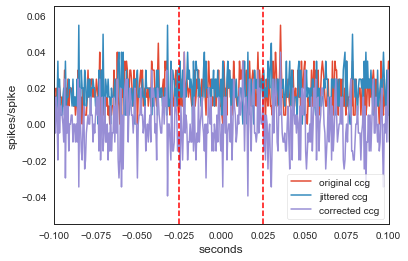

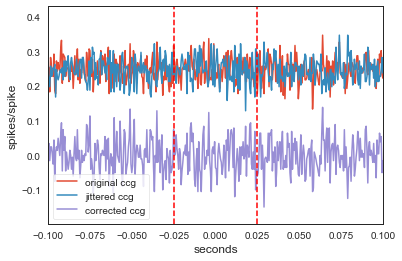

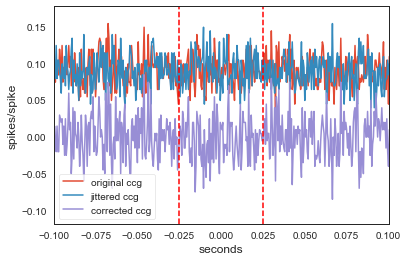

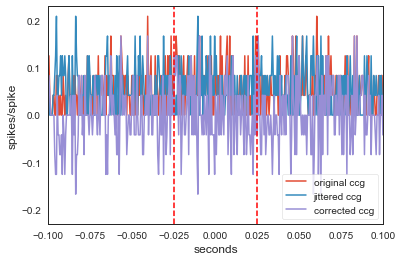

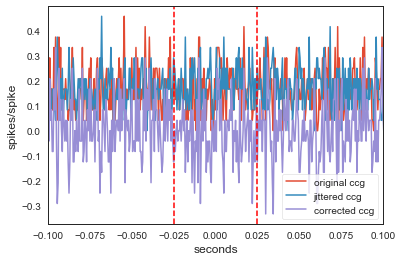

...

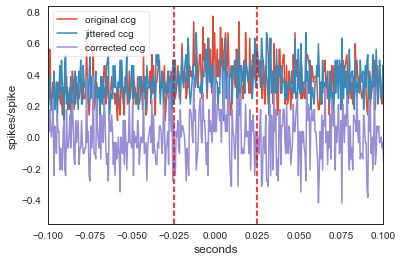

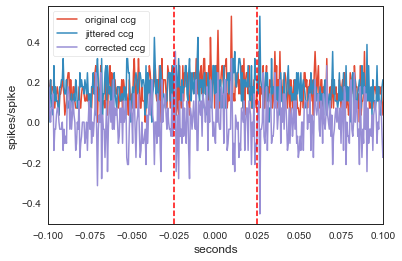

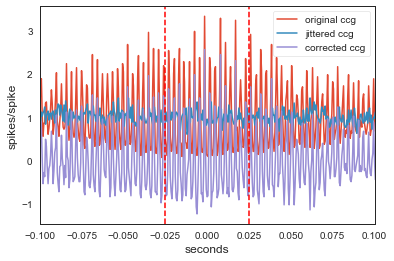

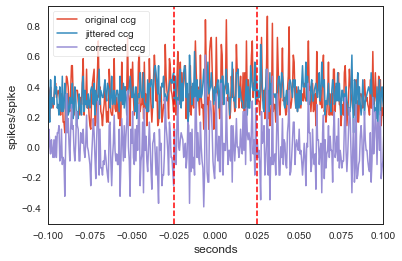

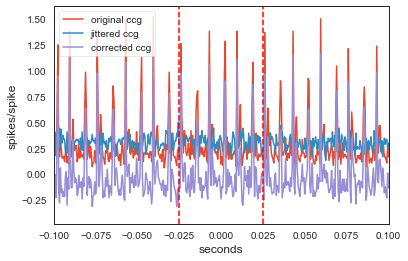

KeyError: 110

<Figure size 432x288 with 0 Axes>

In [75]:
a = np.arange(1,len(df_pairs.jitter_ccg)+1,1)
for i in a:
    plt.figure()
    plt.plot(df_pairs.ccg[i][1][1:],df_pairs.ccg[i][0],label='original ccg')
    plt.plot(df_pairs.jitter_ccg[i][1][1:],df_pairs.jitter_ccg[i][0], label='jittered ccg')
    plt.plot(df_pairs.ccg[i][1][1:],df_pairs.corrected_ccgs[i], label='corrected ccg')
    plt.gca().axvline(0.025,c='r',ls='--')
    plt.gca().axvline(-0.025,c='r',ls='--')
    plt.xlim(-.1,.1)
    plt.xlabel('seconds')
    plt.ylabel('spikes/spike')
    plt.legend()
    plt.show()

In [91]:
t = df_pairs.ccg[1][1][1:]


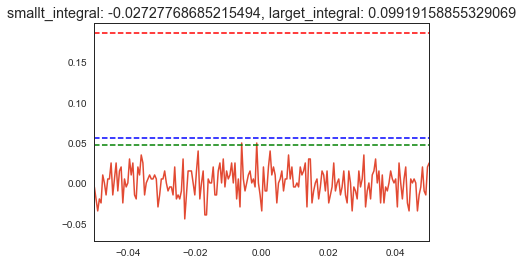

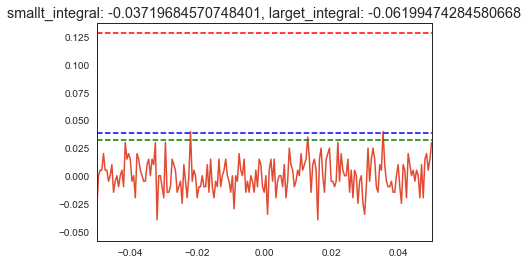

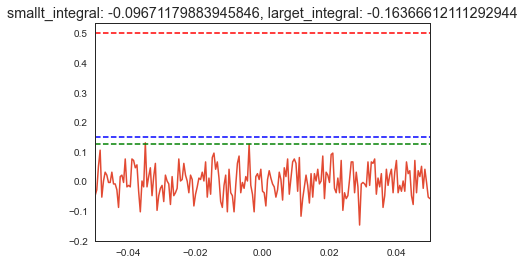

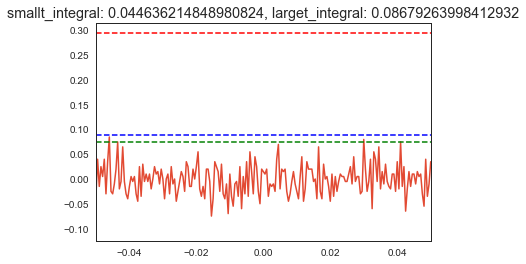

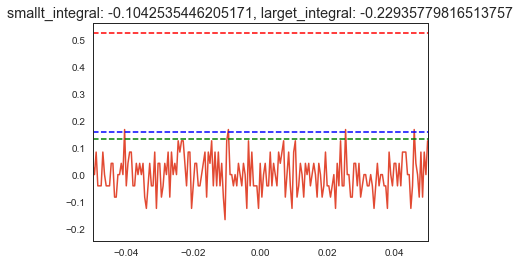

...

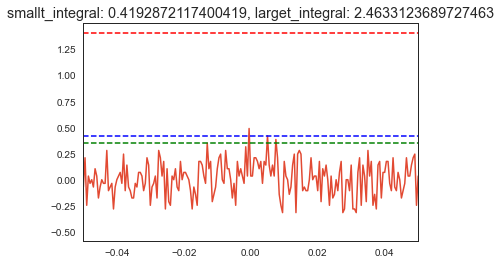

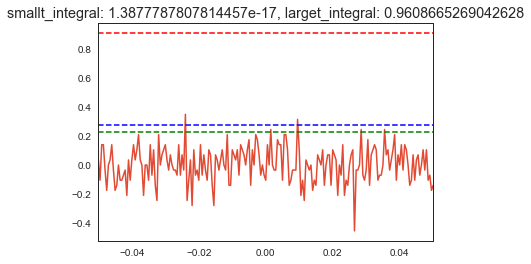

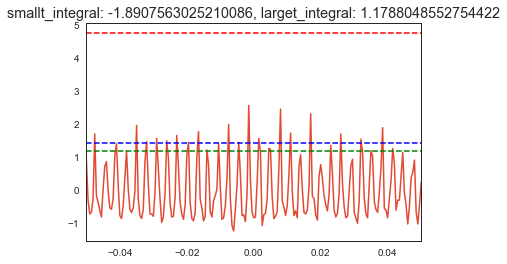

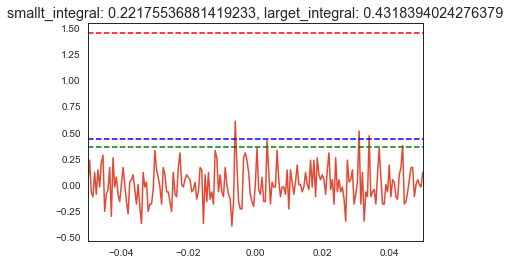

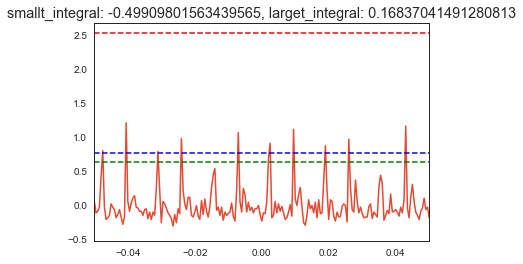

In [97]:
for i,pair in enumerate(df_pairs.corrected_ccgs):
    #mn = np.mean(pair[500:900])
    mn = np.mean(pair)
    std = np.std(pair)
    #std = np.std(pair[500:900])
    areaextmid = np.trapz(pair[990:1010])
    areamid = np.trapz(pair[998:1002])
    mx = max(areaextmid,areamid)
    vert_thresh = mn+(3*std) #if point in mid is over this threshold then it could be a pair
    horiz_thresh = mn+(2.5*std) #if a point outside the "mid" is greater than this number, discard (attempt at peak finding)
    samecell_thresh = mn+(10*std)
    mid = pair[990:1010]
    #if max(mid) == max(pair) then pair
    
    
    
    
    
    plt.figure()
    plt.plot(t,pair)
    plt.gca().axhline(vert_thresh,c='blue',ls='--')
    plt.gca().axhline(samecell_thresh,c='red',ls='--')
    plt.gca().axhline(horiz_thresh,c='green',ls='--')
    plt.xlim(-0.05,.05)
    title = 'smallt_integral: ' + str(areamid) + ', larget_integral: ' +str(areaextmid)
    plt.title(title)
    plt.show() 

In [ ]:
# divide geometric mean by two totals, then normalize, spikes/spikes == (0.5), whereas most values will be 0.005
# 100 microsecond bin size for selected peaks!! assuming 1% or less than 5%
# set threshold to both negative and positive 
# mega raised threshold 

# change to 2 or 5

#flip for negative values as well
finalize with integrals

In [106]:
df_=df[df.mouse==47].reset_index()


In [107]:
dfr_ = df_reaches[df_reaches.mouse==47].reset_index()


In [108]:
# outcome

alltrials,psth,reachs,units_,hist_rastor = analysis.reach_psth(df_,dfr_)


In [109]:
edges=np.arange(-3,8,0.020)


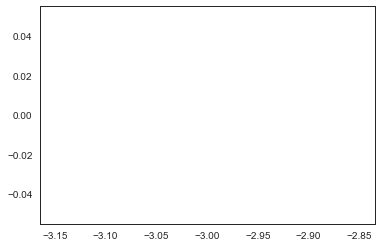

In [110]:
plt.plot(edges[0],psth)


# ignore below

In [84]:
for i,pair in enumerate(pairs):
    areaextmid = np.trapz(pair[490:510])
    areamid = np.trapz(pair[498:502])
    #areabase = np.trapz(pair[450:480])
    #test = abs(areamid/areabase) #normalize somehow
    std = np.std(pair)
    mn = mean(pair)
    vert_thresh = std*3.4 + mn
    horiz_thresh = std*2.0 + mn
    horiz_thresh_rl = std*2.7 + mn
    horiz_thresh_mx = std*10 + mn
    mx = np.max(pair[490:510]) * 0.75
    
    
    
    
    
    plt.figure()
    plt.plot(t,pair)
    plt.gca().axhline(mx,c='blue',ls='--')

    plt.xlim(-0.1,.1)
    title = ccgs[i], areamid, areaextmid
    plt.title(title)
    plt.show() 

In [ ]:
# figure out 
look at activity monitor and make sure it cranks up CPU activity across all CPUs
dask with GPU

df.apply - apply function to df_pairs dataframe

time restricted version of thing using joblib 
apply function for df_pairs dataframe and redo that, how much faster does it make it
if both are unacceptable then think about dask 

could also do cloud compute node, get a bunch of CPUs for a couple hours 